In [1]:
import pandas as pd
import geopandas as gpd
import numpy as np
from sksurv.ensemble import RandomSurvivalForest
from sksurv.linear_model import CoxPHSurvivalAnalysis
from sksurv.preprocessing import OneHotEncoder
import matplotlib.pyplot as plt
from lifelines import KaplanMeierFitter, CoxPHFitter
from shapely.geometry import box
from shapely.ops import nearest_points
from shapely.geometry import box
from shapely.ops import unary_union
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, roc_auc_score, classification_report
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
import seaborn as sns
from sklearn.ensemble import RandomForestClassifier
from shapely import wkt
from scipy.spatial import cKDTree

In [2]:
# Load the data
burn_areas = gpd.read_file('fire-ignitions/campania/campania_burn_areas_2007_2021.shp')
climate_data = pd.read_csv('fire-ignitions/campania/weather_data_2010_2019.csv')
# climate_data_avg = pd.read_csv('fire-ignitions/campania/weather_data_avg_2010_2019.csv')
# Load the data

df_wind = pd.read_csv('fire-ignitions/campania/wind-2007-2020.csv')
df_temp = pd.read_csv('fire-ignitions/campania/temp-2007-2020.csv')
df_rhum = pd.read_csv('fire-ignitions/campania/rhum-2007-2020(in).csv')
df_prcp = pd.read_csv('fire-ignitions/campania/prcp-2007-2020.csv')

campania_areas = gpd.read_file("fire-ignitions/campania/campania_region.shp")
unburned_areas_df = gpd.read_file("unburned_areas_by_date.shp")
campania_areas = gpd.read_file("fire-ignitions/campania/campania_region.shp")
unburned_areas_df = gpd.read_file("unburned_areas_by_date.shp")

In [76]:
# Step 1: Extract only the precipitation value columns (those starting with a year prefix)
value_cols = [col for col in df_prcp.columns if col.isdigit()]

# Step 2: Compute rolling sum across the date columns (axis=1 means across days)
rolling_sum = df_prcp[value_cols].T.rolling(window=20, min_periods=1).sum().T

# Step 3: Reattach metadata columns (id, region, geometry, etc.)
meta_cols = [col for col in df_prcp.columns if col not in value_cols]
df_drought20 = pd.concat([df_prcp[meta_cols], rolling_sum], axis=1)

# Temperature 7-day rolling mean
value_cols = [col for col in df_temp.columns if col.isdigit()]
rolling_mean_temp = df_temp[value_cols].T.rolling(window=7, min_periods=1).mean().T
meta_cols = [col for col in df_temp.columns if col not in value_cols]
df_temp = pd.concat([df_temp[meta_cols], rolling_mean_temp], axis=1)

# Humidity 7-day rolling mean
value_cols = [col for col in df_rhum.columns if col.isdigit()]
rolling_mean_rhum = df_rhum[value_cols].T.rolling(window=7, min_periods=1).mean().T
meta_cols = [col for col in df_rhum.columns if col not in value_cols]
df_rhum = pd.concat([df_rhum[meta_cols], rolling_mean_rhum], axis=1)

# Wind Speed 7-day rolling mean
value_cols = [col for col in df_wind.columns if col.isdigit()]
rolling_mean_wind = df_wind[value_cols].T.rolling(window=7, min_periods=1).mean().T
meta_cols = [col for col in df_wind.columns if col not in value_cols]
df_wind = pd.concat([df_wind[meta_cols], rolling_mean_wind], axis=1)

# (Optional) Preview the result
print(df_drought20.shape)
df_drought20.head()


(650, 5125)


,Unnamed: 0.1,Unnamed: 0,id,NOME_REG,geometry,centre,i,j,lon,lat,...,20201221,20201222,20201223,20201224,20201225,20201226,20201227,20201228,20201229,20201230
0,0,0,7.0,CAMPANIA,"POLYGON ((904298.1073 4575403.8593, 899646.735...",POINT (13.797718424287302 41.23624977589692),438,338,13.8,41.2,...,0.244898,0.193663,0.187737,0.188475,0.175644,0.119841,0.116679,0.073898,0.074676,0.081368
1,1,1,8.0,CAMPANIA,"POLYGON ((904298.1073 4575403.8593, 904298.107...",POINT (13.799088151142858 41.2124892146563),438,338,13.8,41.2,...,0.244898,0.193663,0.187737,0.188475,0.175644,0.119841,0.116679,0.073898,0.074676,0.081368
2,2,2,9.0,CAMPANIA,"POLYGON ((904298.1073 4570403.8593, 904298.107...",POINT (13.81778854619817 41.18161668985922),438,338,13.8,41.2,...,0.244898,0.193663,0.187737,0.188475,0.175644,0.119841,0.116679,0.073898,0.074676,0.081368
3,3,3,36.0,CAMPANIA,"POLYGON ((909298.1073 4595403.8593, 907096.606...",POINT (13.880295013351727 41.415264057473514),439,336,13.9,41.4,...,0.224247,0.170065,0.162272,0.160601,0.140356,0.089113,0.087981,0.061519,0.072207,0.083150
4,4,4,37.0,CAMPANIA,"POLYGON ((909298.1073 4595403.8593, 909298.107...",POINT (13.88410251079047 41.3820587639613),439,336,13.9,41.4,...,0.224247,0.170065,0.162272,0.160601,0.140356,0.089113,0.087981,0.061519,0.072207,0.083150


In [77]:
def protect_geometry(line):
    # Find where geometry starts and ends (rough approach)
    if "POLYGON" in line or "MULTIPOLYGON" in line:
        geo_start = line.find("POLYGON")
        if geo_start == -1:
            geo_start = line.find("MULTIPOLYGON")

        # Geometry might go until the next double quote or end of line
        quote_start = line.rfind('"', 0, geo_start)
        quote_end = line.find('"', geo_start)
        
        if quote_start != -1 and quote_end != -1:
            geometry = line[quote_start+1 : quote_end]
            protected_geometry = geometry.replace(",", "|")
            line = line[:quote_start+1] + protected_geometry + line[quote_end:]
    return line

# Read and combine every 2 lines
with open("fire-ignitions/campania/rhum-2007-2020(in).csv", "r") as f:
    lines = [line.strip() for line in f.readlines()]

combined_lines = []
for i in range(0, len(lines) - 1, 2):
    combined = lines[i] + "," + lines[i + 1]
    combined = protect_geometry(combined)
    combined_lines.append(combined)

# Split lines safely
data = [line.split(",") for line in combined_lines]

# Turn into DataFrame
df_rhum = pd.DataFrame(data)

# Drop all-NaN columns
df_rhum = df_rhum.dropna(axis=1, how="all")

# First row as header
df_rhum.columns = df_rhum.iloc[0]
df_rhum = df_rhum[1:].reset_index(drop=True)
df_rhum = df_rhum.drop(df_rhum.columns[0], axis=1)

In [78]:
import pandas as pd
from datetime import datetime, timedelta

# file_paths = {
#     "temp": "fire-ignitions/campania/temp-2007-2020.csv",
#     "prcp": "fire-ignitions/campania/prcp-2007-2020.csv",
#     "wind": "fire-ignitions/campania/wind-2007-2020.csv",
#     # "rhum": "fire-ignitions/campania/rhum-2007-2020.csv",  # add this if needed
# }

# Correctly interpret 7-digit columns as YYYYMM + 0-indexed day
def parse_zero_indexed_day(col_str):
    try:
        if len(col_str) == 7:
            year = int(col_str[:4])
            month = int(col_str[4:6])
            day_offset = int(col_str[6])
            corrected_date = datetime(year, month, 1) + timedelta(days=day_offset)
            return corrected_date.strftime("%Y%m%d")
        elif len(col_str) == 8:
            return col_str  # already correct
        else:
            return col_str  # unrecognized format
    except:
        return col_str

# Function to reshape climate data
def reshape_climate_data(df, variable_name):
    df = df.copy()
    
    # Apply date parser to column names
    df.columns = [
        parse_zero_indexed_day(str(col)) if str(col).isdigit() else col
        for col in df.columns
    ]

    # Melt from wide to long format
    df_long = df.melt(id_vars=["id"], var_name="date_str", value_name=variable_name)
    
    # Convert to datetime
    df_long["date"] = pd.to_datetime(df_long["date_str"], format="%Y%m%d", errors="coerce")
    df_long.drop(columns=["date_str"], inplace=True)
    return df_long

# Load datasets (skipping index column)
# df_temp = pd.read_csv(file_paths["temp"], index_col=0)
# df_prcp = pd.read_csv(file_paths["prcp"], index_col=0)
# df_wind = pd.read_csv(file_paths["wind"], index_col=0)
# # df_rhum = pd.read_csv(file_paths["rhum"], index_col=0)  # Uncomment if needed

# Reshape datasets
df_temp = reshape_climate_data(df_temp, "temperature")
df_prcp = reshape_climate_data(df_prcp, "precipitation")
df_wind = reshape_climate_data(df_wind, "wind_speed")
df_drought20 = reshape_climate_data(df_drought20, "drought20")
df_rhum = reshape_climate_data(df_rhum, "humidity")


In [79]:
# remove NaN values
df_temp = df_temp.dropna()
df_prcp = df_prcp.dropna()
df_wind = df_wind.dropna()
df_drought20 = df_drought20.dropna()
df_rhum = df_rhum.dropna()

In [80]:
# Ensure 'data_inc' column is in datetime format
burn_areas['data_inc'] = pd.to_datetime(burn_areas['data_inc'], format="%d/%m/%Y", errors='coerce')

burn_areas = burn_areas.sort_values(by='data_inc', ascending=True)
# Drop rows with invalid date values (NaT)
burn_areas = burn_areas.dropna(subset=['data_inc'])

In [81]:
# Ensure burn_areas only contains data from 2007 to 2020
burn_areas = burn_areas[(burn_areas["data_inc"] >= "2007-01-01") & (burn_areas["data_inc"] <= "2020-12-31")]



In [ ]:
# burn_areas

,gid,loc,data_inc,ora_ev,data_ril,anno,sup_calc,supcalcb,supcalcnb,area_tot,date_form,geometry
2121,4600,LAURI,2007-01-13,None,13/01/2007,2007.0,72035.0,NaN,NaN,72035.00000,dd/MM/yyyy,"POLYGON ((1035560.757 4463307.157, 1035572.755..."
1739,4218,Cornia - Acqua della Nocella,2007-01-13,None,13/01/2007,2007.0,8065.0,NaN,NaN,8065.00000,dd/MM/yyyy,"POLYGON ((1039642.44 4466233.632, 1039642.404 ..."
2252,4731,PANORAMICA,2007-01-27,None,02/02/2007,2007.0,18315.0,NaN,NaN,18315.00000,dd/MM/yyyy,"POLYGON ((982437.548 4546854.351, 982436.981 4..."
2265,4744,PANORAMICA,2007-01-27,None,02/02/2007,2007.0,3391.0,NaN,NaN,3391.00000,dd/MM/yyyy,"POLYGON ((981754.83 4547151.611, 981734.749 45..."
2241,4720,PANORAMICA,2007-01-27,None,02/02/2007,2007.0,3368.0,NaN,NaN,3368.00000,dd/MM/yyyy,"POLYGON ((983031.189 4546970.26, 983025.439 45..."
...,...,...,...,...,...,...,...,...,...,...,...,...
9707,65834,Cornia,2020-11-09,11:34,09/11/2020,2020.0,NaN,NaN,NaN,0.55041,dd/MM/yyyy,"POLYGON ((1039648.457 4466315.043, 1039648.7 4..."
9687,65814,Rialto,2020-11-10,16:50,10/11/2020,2020.0,NaN,NaN,NaN,2.30882,dd/MM/yyyy,"POLYGON ((979600.767 4545489.531, 979548.103 4..."
9675,65802,litto,2020-11-11,09:00,11/11/2020,2020.0,NaN,NaN,NaN,0.46148,dd/MM/yyyy,"POLYGON ((978455.906 4547279.699, 978432.391 4..."
9695,65822,La Cella,2020-11-12,16:20,12/11/2020,2020.0,NaN,NaN,NaN,2.34978,dd/MM/yyyy,"POLYGON ((1040299.11 4452465.094, 1040258.108 ..."


In [82]:
dates = pd.date_range(start='2007/01/01', end='2020/12/31', freq='D')
daily_fires = pd.DataFrame({'date': dates})

# Convert fire dates, ensuring correct format
burn_areas['data_inc'] = pd.to_datetime(burn_areas['data_inc'], format="%d/%m/%Y", errors='coerce')
fire_dates = burn_areas['data_inc'].dropna().dt.normalize()

# Mark days with fires (1) and days without (0)
daily_fires['fire_occurred'] = daily_fires['date'].isin(fire_dates).astype(int)

# Initialize days_since_last_fire column
daily_fires['days_since_last_fire'] = 0
days_since = 0  # Counter to track days since last fire

# Iterate through rows and compute days since last fire
for i in range(len(daily_fires)):
    if daily_fires.loc[i, 'fire_occurred'] == 1:
        # 🔹 The fire day itself continues counting
        daily_fires.loc[i, 'days_since_last_fire'] = days_since + 1  
        days_since += 1  # Keep counting
        
        # 🔹 Reset the counter **only for the next day**
        if i + 1 < len(daily_fires):
            daily_fires.loc[i + 1, 'days_since_last_fire'] = 0  # Reset next day
            days_since = 0  # Reset counter
    else:
        # 🔹 Normal counting for non-fire days
        daily_fires.loc[i, 'days_since_last_fire'] = days_since
        days_since += 1  

# Display result
print(daily_fires.tail(10))

           date  fire_occurred  days_since_last_fire
5104 2020-12-22              0                    28
5105 2020-12-23              0                    29
5106 2020-12-24              0                    30
5107 2020-12-25              0                    31
5108 2020-12-26              0                    32
5109 2020-12-27              0                    33
5110 2020-12-28              0                    34
5111 2020-12-29              0                    35
5112 2020-12-30              0                    36
5113 2020-12-31              0                    37


In [ ]:

# # Generate all dates in the range 2010-01-01 to 2019-12-31
# dates = pd.date_range(start='2010/01/01', end='2019/12/31', freq='D')
# daily_fires = pd.DataFrame({'date': dates})

# # Convert fire dates, ensuring correct format
# burn_areas['data_inc'] = pd.to_datetime(burn_areas['data_inc'], format="%d/%m/%Y", errors='coerce')
# fire_dates = burn_areas['data_inc'].dropna().dt.normalize()

# # Mark days with fires (1) and days without (0)
# daily_fires['fire_occurred'] = daily_fires['date'].isin(fire_dates).astype(int)

# # Compute days since last fire
# # Initialize the column with NaN
# daily_fires['days_since_last_fire'] = np.nan

# # Create a Series of fire dates
# fire_dates_series = daily_fires[daily_fires['fire_occurred'] == 1]['date']

# # Calculate days since last fire using cumulative fire dates
# last_fire_date = None
# for i, row in daily_fires.iterrows():
#     if row['fire_occurred'] == 1:
#         last_fire_date = row['date']
#     if last_fire_date is not None:
#         daily_fires.at[i, 'days_since_last_fire'] = (row['date'] - last_fire_date).days

# # Fill NaN values with 0 to indicate no previous fire recorded
# daily_fires['days_since_last_fire'] = daily_fires['days_since_last_fire'].fillna(0)

# daily_fires['cumulative_fires'] = daily_fires['fire_occurred'].cumsum()

# # Group by cumulative fires and calculate days since last fire
# daily_fires['days_since_last_fire'] = daily_fires.groupby('cumulative_fires').cumcount()

# # Drop the temporary column
# daily_fires.drop(columns=['cumulative_fires'], inplace=True)

# # Display result
# print(daily_fires)

           date  fire_occurred  days_since_last_fire
0    2010-01-01              0                     0
1    2010-01-02              0                     1
2    2010-01-03              0                     2
3    2010-01-04              0                     3
4    2010-01-05              0                     4
...         ...            ...                   ...
3647 2019-12-27              0                    58
3648 2019-12-28              0                    59
3649 2019-12-29              0                    60
3650 2019-12-30              1                     0
3651 2019-12-31              0                     1

[3652 rows x 3 columns]


In [83]:
climate_data = climate_data.iloc[2:].reset_index(drop=True)
climate_data['Date'] = pd.to_datetime(climate_data['Date'], format="%Y-%m-%d", errors='coerce')

# columns for the model
climate_data = climate_data[['Date', 'Temperature', 'Dew_Point', 'Humidity', 'Pressure', 'Wind_Speed', 'Precipitation']]

In [84]:
# merge the weather data with the survival data 
survival_df = pd.merge(daily_fires, climate_data, left_on='date', right_on='Date', how='left')
# survival_df = daily_fires.merge(df_wind, on='date', how='left')\
#                          .merge(df_temp, on='date', how='left')\
#                          .merge(df_prcp, on='date', how='left')

# 
survival_df.drop(columns=['Date'], inplace=True)

# removing first day of the year
survival_df = survival_df[survival_df['date'].dt.dayofyear != 1]

In [85]:
burn_areas_filtered = burn_areas[(burn_areas['data_inc'] >= '2007-01-01') & (burn_areas['data_inc'] <= '2020-12-31')]

In [86]:
# include all fire incidents
expanded_df = pd.merge(survival_df, burn_areas_filtered[['data_inc', 'sup_calc', 'geometry']], 
                       left_on='date', right_on='data_inc', how='left')

# Drop the extra date column from the merge
expanded_df.drop(columns=['data_inc'], inplace=True)

# Fill NaN values in 'sup_calcb' and 'geometry' for dates with no fire
expanded_df['sup_calc'] = expanded_df['sup_calc'].fillna(0)
expanded_df['geometry'] = expanded_df['geometry'].fillna(np.nan)

# Display the final DataFrame
expanded_df

,date,fire_occurred,days_since_last_fire,Temperature,Dew_Point,Humidity,Pressure,Wind_Speed,Precipitation,sup_calc,geometry
0,2007-01-02,0,1,NaN,NaN,NaN,NaN,NaN,NaN,0.0,None
1,2007-01-03,0,2,NaN,NaN,NaN,NaN,NaN,NaN,0.0,None
2,2007-01-04,0,3,NaN,NaN,NaN,NaN,NaN,NaN,0.0,None
3,2007-01-05,0,4,NaN,NaN,NaN,NaN,NaN,NaN,0.0,None
4,2007-01-06,0,5,NaN,NaN,NaN,NaN,NaN,NaN,0.0,None
...,...,...,...,...,...,...,...,...,...,...,...
12965,2020-12-27,0,33,NaN,NaN,NaN,NaN,NaN,NaN,0.0,None
12966,2020-12-28,0,34,NaN,NaN,NaN,NaN,NaN,NaN,0.0,None
12967,2020-12-29,0,35,NaN,NaN,NaN,NaN,NaN,NaN,0.0,None
12968,2020-12-30,0,36,NaN,NaN,NaN,NaN,NaN,NaN,0.0,None


In [ ]:
# survival_df.head(), burn_areas_filtered.head()

(        date  fire_occurred  days_since_last_fire Temperature Dew_Point  \
 1 2007-01-02              0                     1         NaN       NaN   
 2 2007-01-03              0                     2         NaN       NaN   
 3 2007-01-04              0                     3         NaN       NaN   
 4 2007-01-05              0                     4         NaN       NaN   
 5 2007-01-06              0                     5         NaN       NaN   
 
   Humidity Pressure Wind_Speed Precipitation  
 1      NaN      NaN        NaN           NaN  
 2      NaN      NaN        NaN           NaN  
 3      NaN      NaN        NaN           NaN  
 4      NaN      NaN        NaN           NaN  
 5      NaN      NaN        NaN           NaN  ,
 Empty GeoDataFrame
 Columns: [gid, loc, data_inc, ora_ev, data_ril, anno, sup_calc, supcalcb, supcalcnb, area_tot, date_form, geometry]
 Index: [])

In [87]:
unburn_areas_filtered = unburned_areas_df[(unburned_areas_df['date'] >= '2007-01-01') & (unburned_areas_df['date'] <= '2020-12-31')]
unburn_areas_filtered

,date,burned_geo,geometry
1,2007-01-13,POLYGON ((1035560.7572162582 4463307.157470708...,"MULTIPOLYGON (((914635.79 4523075.91, 914611.5..."
2,2007-01-13,"POLYGON ((1039642.4395673146 4466233.63213242,...","MULTIPOLYGON (((914635.79 4523075.91, 914611.5..."
3,2007-01-27,"POLYGON ((982437.5481712454 4546854.350644202,...","MULTIPOLYGON (((914635.79 4523075.91, 914611.5..."
4,2007-01-27,"POLYGON ((981754.8300723156 4547151.610700977,...","MULTIPOLYGON (((914635.79 4523075.91, 914611.5..."
5,2007-01-27,"POLYGON ((983031.1892013222 4546970.260318218,...","MULTIPOLYGON (((914635.79 4523075.91, 914611.5..."
...,...,...,...
9359,2020-11-09,"POLYGON ((1039648.4572493633 4466315.04326979,...","MULTIPOLYGON (((914635.79 4523075.91, 914611.5..."
9360,2020-11-10,"POLYGON ((979600.7666277869 4545489.530636689,...","MULTIPOLYGON (((914635.79 4523075.91, 914611.5..."
9361,2020-11-11,"POLYGON ((978455.9059985494 4547279.699174826,...","MULTIPOLYGON (((914635.79 4523075.91, 914611.5..."
9362,2020-11-12,POLYGON ((1040299.1104286009 4452465.094037161...,"MULTIPOLYGON (((914635.79 4523075.91, 914611.5..."


In [88]:
unburn_areas_filtered['date'] = pd.to_datetime(unburn_areas_filtered['date'])
expanded_dff = pd.merge(survival_df, unburn_areas_filtered[['date', 'geometry', 'burned_geo']],
                        left_on='date', right_on='date', how='left')


c:\Users\hclt0\anaconda3\envs\bachpro\lib\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [ ]:
# print(expanded_dff)

            date  fire_occurred  days_since_last_fire Temperature Dew_Point  \
0     2007-01-02              0                     1         NaN       NaN   
1     2007-01-03              0                     2         NaN       NaN   
2     2007-01-04              0                     3         NaN       NaN   
3     2007-01-05              0                     4         NaN       NaN   
4     2007-01-06              0                     5         NaN       NaN   
...          ...            ...                   ...         ...       ...   
12965 2020-12-27              0                    33         NaN       NaN   
12966 2020-12-28              0                    34         NaN       NaN   
12967 2020-12-29              0                    35         NaN       NaN   
12968 2020-12-30              0                    36         NaN       NaN   
12969 2020-12-31              0                    37         NaN       NaN   

      Humidity Pressure Wind_Speed Precipitation ge

In [ ]:
# survival_df

,date,fire_occurred,days_since_last_fire,Temperature,Dew_Point,Humidity,Pressure,Wind_Speed,Precipitation
1,2007-01-02,0,1,NaN,NaN,NaN,NaN,NaN,NaN
2,2007-01-03,0,2,NaN,NaN,NaN,NaN,NaN,NaN
3,2007-01-04,0,3,NaN,NaN,NaN,NaN,NaN,NaN
4,2007-01-05,0,4,NaN,NaN,NaN,NaN,NaN,NaN
5,2007-01-06,0,5,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
5109,2020-12-27,0,33,NaN,NaN,NaN,NaN,NaN,NaN
5110,2020-12-28,0,34,NaN,NaN,NaN,NaN,NaN,NaN
5111,2020-12-29,0,35,NaN,NaN,NaN,NaN,NaN,NaN
5112,2020-12-30,0,36,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
survival_df

,date,fire_occurred,days_since_last_fire,Temperature,Dew_Point,Humidity,Pressure,Wind_Speed,Precipitation
1,2007-01-02,0,1,NaN,NaN,NaN,NaN,NaN,NaN
2,2007-01-03,0,2,NaN,NaN,NaN,NaN,NaN,NaN
3,2007-01-04,0,3,NaN,NaN,NaN,NaN,NaN,NaN
4,2007-01-05,0,4,NaN,NaN,NaN,NaN,NaN,NaN
5,2007-01-06,0,5,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
5109,2020-12-27,0,33,NaN,NaN,NaN,NaN,NaN,NaN
5110,2020-12-28,0,34,NaN,NaN,NaN,NaN,NaN,NaN
5111,2020-12-29,0,35,NaN,NaN,NaN,NaN,NaN,NaN
5112,2020-12-30,0,36,NaN,NaN,NaN,NaN,NaN,NaN


In [89]:
expanded_dff = pd.merge(survival_df, unburn_areas_filtered[['date', 'geometry']],
                        left_on='date', right_on='date', how='left')

In [ ]:
# expanded_dff

,date,fire_occurred,days_since_last_fire,Temperature,Dew_Point,Humidity,Pressure,Wind_Speed,Precipitation,geometry
0,2007-01-02,0,1,NaN,NaN,NaN,NaN,NaN,NaN,None
1,2007-01-03,0,2,NaN,NaN,NaN,NaN,NaN,NaN,None
2,2007-01-04,0,3,NaN,NaN,NaN,NaN,NaN,NaN,None
3,2007-01-05,0,4,NaN,NaN,NaN,NaN,NaN,NaN,None
4,2007-01-06,0,5,NaN,NaN,NaN,NaN,NaN,NaN,None
...,...,...,...,...,...,...,...,...,...,...
12965,2020-12-27,0,33,NaN,NaN,NaN,NaN,NaN,NaN,None
12966,2020-12-28,0,34,NaN,NaN,NaN,NaN,NaN,NaN,None
12967,2020-12-29,0,35,NaN,NaN,NaN,NaN,NaN,NaN,None
12968,2020-12-30,0,36,NaN,NaN,NaN,NaN,NaN,NaN,None


In [90]:
expanded_dff.rename(columns={'geometry': 'unburned_area'}, inplace=True)
expanded_dff

,date,fire_occurred,days_since_last_fire,Temperature,Dew_Point,Humidity,Pressure,Wind_Speed,Precipitation,unburned_area
0,2007-01-02,0,1,NaN,NaN,NaN,NaN,NaN,NaN,None
1,2007-01-03,0,2,NaN,NaN,NaN,NaN,NaN,NaN,None
2,2007-01-04,0,3,NaN,NaN,NaN,NaN,NaN,NaN,None
3,2007-01-05,0,4,NaN,NaN,NaN,NaN,NaN,NaN,None
4,2007-01-06,0,5,NaN,NaN,NaN,NaN,NaN,NaN,None
...,...,...,...,...,...,...,...,...,...,...
12965,2020-12-27,0,33,NaN,NaN,NaN,NaN,NaN,NaN,None
12966,2020-12-28,0,34,NaN,NaN,NaN,NaN,NaN,NaN,None
12967,2020-12-29,0,35,NaN,NaN,NaN,NaN,NaN,NaN,None
12968,2020-12-30,0,36,NaN,NaN,NaN,NaN,NaN,NaN,None


In [91]:
survival_df = pd.merge(survival_df, burn_areas_filtered[['data_inc', 'sup_calc', 'geometry']], 
                       left_on='date', right_on='data_inc', how='right')
survival_df.drop(columns=['data_inc'], inplace=True)

In [ ]:
# hertil1

In [92]:
# list of columns to clean
columns_to_clean = ["Temperature", "Dew_Point", "Humidity", "Pressure", "Wind_Speed", "Precipitation"]

# cleaning the columns
for col in columns_to_clean:
    expanded_dff[col]=expanded_dff[col].astype(str).str.split('|').str[0]  # Keep only SI values 

# converting the columns to numeric
expanded_dff[columns_to_clean] = expanded_dff[columns_to_clean].apply(pd.to_numeric, errors='coerce')

# Display the cleaned dataframe
expanded_dff


,date,fire_occurred,days_since_last_fire,Temperature,Dew_Point,Humidity,Pressure,Wind_Speed,Precipitation,unburned_area
0,2007-01-02,0,1,NaN,NaN,NaN,NaN,NaN,NaN,None
1,2007-01-03,0,2,NaN,NaN,NaN,NaN,NaN,NaN,None
2,2007-01-04,0,3,NaN,NaN,NaN,NaN,NaN,NaN,None
3,2007-01-05,0,4,NaN,NaN,NaN,NaN,NaN,NaN,None
4,2007-01-06,0,5,NaN,NaN,NaN,NaN,NaN,NaN,None
...,...,...,...,...,...,...,...,...,...,...
12965,2020-12-27,0,33,NaN,NaN,NaN,NaN,NaN,NaN,None
12966,2020-12-28,0,34,NaN,NaN,NaN,NaN,NaN,NaN,None
12967,2020-12-29,0,35,NaN,NaN,NaN,NaN,NaN,NaN,None
12968,2020-12-30,0,36,NaN,NaN,NaN,NaN,NaN,NaN,None


In [93]:
# list of columns to clean
columns_to_clean = ["Temperature", "Dew_Point", "Humidity", "Pressure", "Wind_Speed", "Precipitation"]

# cleaning the columns
for col in columns_to_clean:
    expanded_dff[col]=expanded_dff[col].astype(str).str.split('|').str[0]  # Keep only SI values 

# converting the columns to numeric
expanded_dff[columns_to_clean] = expanded_dff[columns_to_clean].apply(pd.to_numeric, errors='coerce')

# Display the cleaned dataframe
expanded_dff


,date,fire_occurred,days_since_last_fire,Temperature,Dew_Point,Humidity,Pressure,Wind_Speed,Precipitation,unburned_area
0,2007-01-02,0,1,NaN,NaN,NaN,NaN,NaN,NaN,None
1,2007-01-03,0,2,NaN,NaN,NaN,NaN,NaN,NaN,None
2,2007-01-04,0,3,NaN,NaN,NaN,NaN,NaN,NaN,None
3,2007-01-05,0,4,NaN,NaN,NaN,NaN,NaN,NaN,None
4,2007-01-06,0,5,NaN,NaN,NaN,NaN,NaN,NaN,None
...,...,...,...,...,...,...,...,...,...,...
12965,2020-12-27,0,33,NaN,NaN,NaN,NaN,NaN,NaN,None
12966,2020-12-28,0,34,NaN,NaN,NaN,NaN,NaN,NaN,None
12967,2020-12-29,0,35,NaN,NaN,NaN,NaN,NaN,NaN,None
12968,2020-12-30,0,36,NaN,NaN,NaN,NaN,NaN,NaN,None


In [94]:
# may not use this anymore

minx, miny, maxx, maxy = campania_areas.total_bounds
grid_size = 5000
grid_cells = []
x_coords = np.arange(minx, maxx, grid_size)
y_coords = np.arange(miny, maxy, grid_size)

for x in x_coords:
    for y in y_coords:
        grid_cells.append(box(x, y, x + grid_size, y + grid_size))

grid = gpd.GeoDataFrame(geometry=grid_cells, crs=campania_areas.crs)
grid = grid[grid.intersects(campania_areas.unary_union)]

C:\Users\hclt0\AppData\Local\Temp\ipykernel_2664\2332083185.py:14: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  grid = grid[grid.intersects(campania_areas.unary_union)]


       id       road  powerline  night_ligh  mean_eleva   max_elevat  \
586   990  10534.794        0.0   18.664966  227.120447   540.070007   
607  1023      0.000        0.0    0.000000  231.017350   425.390015   
585   989   4944.377        0.0    1.834325  568.306170  1206.079956   
606  1022  11289.340        0.0   22.541087  365.697030  1066.170044   
637  1121   2446.550        0.0    1.336134  407.721231   687.750000   

      slope30     north      east     south      west       wui    agriNA  \
586  0.054818  0.112050  0.064270  0.696951  0.126729  0.024281  0.028115   
607  0.685846  0.210587  0.129459  0.658803  0.001151  0.000000  0.009615   
585  0.039772  0.235954  0.064847  0.533471  0.165728  0.000000  0.031020   
606  0.126865  0.270081  0.284932  0.415598  0.029389  0.055300  0.327189   
637  0.243072  0.190420  0.002771  0.683492  0.123317  0.000000  0.000000   

        grass    forest     shrub     other      agri  \
586  0.045367  0.099681  0.153355  0.029393  0.

<Axes: >

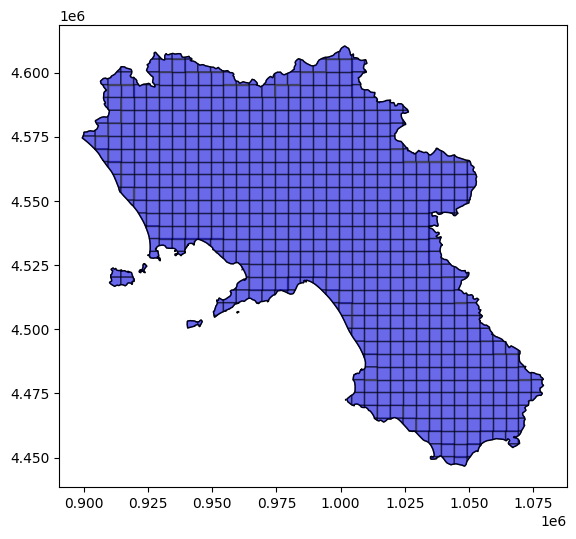

In [95]:
# # Plot the Campania boundary
# fig, ax = plt.subplots(figsize=(10, 10))
# campania_areas.plot(ax=ax, color="lightgray", edgecolor="black", alpha=0.5, label="Campania")


# # Plot the grid
# grid.boundary.plot(ax=ax, color="red", linewidth=0.5, alpha=0.7, label="Grid Cells")

# # Plot wildfires
# # fires.plot(ax=ax, color="orange", markersize=5, alpha=0.7, label="Wildfires")

# # Add legend and title
# plt.legend()
# plt.title("Campania Wildfire Grid Visualization")
# plt.xlabel("Longitude")
# plt.ylabel("Latitude")
# plt.show()


static = gpd.read_file("static-predictors/static_predictors.shp")
def clean_wkt_format(wkt):
    """Fix incorrect WKT format with excessive brackets in MultiPolygons and Polygons."""
    if not isinstance(wkt, str):
        return None  # Return None if not a string

    # Fix MultiPolygon formatting
    if wkt.startswith("MULTIPOLYGON((("):
        wkt = re.sub(r"MULTIPOLYGON\(\(\(", "MULTIPOLYGON((", wkt)

    # Fix Polygon formatting
    elif wkt.startswith("POLYGON(("):
        wkt = re.sub(r"POLYGON\(\(", "POLYGON(", wkt)

    return wkt

# If geometries are stored as WKT strings, apply cleaning function
if static['geometry'].dtype == 'object':
    static['geometry'] = static['geometry'].apply(clean_wkt_format)

# Convert to a valid GeoDataFrame
static = static.set_geometry("geometry")

# Ensure CRS is set (assuming EPSG:23032 as before)
static.set_crs(epsg=23032, inplace=True)

# Fix invalid geometries using buffer(0)
static['geometry'] = static['geometry'].apply(lambda g: g.buffer(0) if g and not g.is_valid else g)

# Drop empty geometries (if any exist)
static = static[~static['geometry'].is_empty]
static_clipped = gpd.clip(static, campania_areas)
print(static_clipped.head())
# Plot to visualize
ax = campania_areas.plot(color='lightgrey', edgecolor='black', figsize=(8,6))
static_clipped.plot(ax=ax, color='blue', edgecolor='black', alpha=0.5)


In [ ]:
# static

,id,road,powerline,night_ligh,mean_eleva,max_elevat,slope30,north,east,south,west,wui,agriNA,grass,forest,shrub,other,agri,geometry
0,7,7839.256,0.000000,37.439776,2.851034,8.060000,0.003205,0.352508,0.126903,0.397613,0.122977,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.956463,"POLYGON ((904298.107 4575403.859, 899646.736 4..."
1,8,3852.088,0.000000,28.750000,1.770057,13.330000,0.000614,0.388589,0.116919,0.357955,0.136537,0.064311,0.000000,0.000000,0.065724,0.000000,0.000000,0.826855,"POLYGON ((904298.107 4575403.859, 904298.107 4..."
2,9,0.000,0.000000,85.169300,3.660714,6.360000,0.000000,0.265306,0.000000,0.244898,0.489796,0.000000,0.000000,0.000000,0.500000,0.000000,0.000000,0.000000,"POLYGON ((904298.107 4570403.859, 904298.107 4..."
3,36,4397.108,4156.552271,42.208791,49.715223,72.970001,0.003726,0.263196,0.076796,0.574519,0.085490,0.047535,0.066901,0.000000,0.126761,0.000000,0.000000,0.172535,"POLYGON ((909298.107 4595403.859, 907096.607 4..."
4,37,4626.213,6344.676669,20.191429,41.456366,137.389999,0.003129,0.339244,0.036940,0.317514,0.306302,0.028875,0.000000,0.000000,0.065350,0.000000,0.000000,0.396657,"POLYGON ((909298.107 4595403.859, 909298.107 4..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
645,1153,441.416,847.636084,0.467532,856.434455,1200.810059,0.096447,0.316751,0.011506,0.520812,0.150931,0.000000,0.097297,0.000000,0.172973,0.675676,0.054054,0.000000,"MULTIPOLYGON (((1070497.235 4460403.859, 10703..."
646,1154,0.000,0.000000,1.646934,696.831655,706.390015,0.333333,0.888889,0.000000,0.000000,0.111111,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,"POLYGON ((1069415.647 4455403.859, 1069410.811..."
647,1181,3560.217,0.000000,0.530220,894.592865,1085.650024,0.012394,0.393996,0.061007,0.385526,0.159471,0.000000,0.006297,0.003778,0.371537,0.161209,0.065491,0.010076,"POLYGON ((1074298.107 4480403.859, 1074298.107..."
648,1182,6738.802,0.000000,8.374424,943.008600,1223.270020,0.032157,0.492535,0.085102,0.288724,0.133638,0.000000,0.011000,0.106500,0.283500,0.042500,0.059500,0.148500,"POLYGON ((1078808.173 4480403.859, 1078536.4 4..."


In [ ]:
# burn_areas_filtered

,gid,loc,data_inc,ora_ev,data_ril,anno,sup_calc,supcalcb,supcalcnb,area_tot,date_form,geometry
2121,4600,LAURI,2007-01-13,None,13/01/2007,2007.0,72035.0,NaN,NaN,72035.00000,dd/MM/yyyy,"POLYGON ((1035560.757 4463307.157, 1035572.755..."
1739,4218,Cornia - Acqua della Nocella,2007-01-13,None,13/01/2007,2007.0,8065.0,NaN,NaN,8065.00000,dd/MM/yyyy,"POLYGON ((1039642.44 4466233.632, 1039642.404 ..."
2252,4731,PANORAMICA,2007-01-27,None,02/02/2007,2007.0,18315.0,NaN,NaN,18315.00000,dd/MM/yyyy,"POLYGON ((982437.548 4546854.351, 982436.981 4..."
2265,4744,PANORAMICA,2007-01-27,None,02/02/2007,2007.0,3391.0,NaN,NaN,3391.00000,dd/MM/yyyy,"POLYGON ((981754.83 4547151.611, 981734.749 45..."
2241,4720,PANORAMICA,2007-01-27,None,02/02/2007,2007.0,3368.0,NaN,NaN,3368.00000,dd/MM/yyyy,"POLYGON ((983031.189 4546970.26, 983025.439 45..."
...,...,...,...,...,...,...,...,...,...,...,...,...
9707,65834,Cornia,2020-11-09,11:34,09/11/2020,2020.0,NaN,NaN,NaN,0.55041,dd/MM/yyyy,"POLYGON ((1039648.457 4466315.043, 1039648.7 4..."
9687,65814,Rialto,2020-11-10,16:50,10/11/2020,2020.0,NaN,NaN,NaN,2.30882,dd/MM/yyyy,"POLYGON ((979600.767 4545489.531, 979548.103 4..."
9675,65802,litto,2020-11-11,09:00,11/11/2020,2020.0,NaN,NaN,NaN,0.46148,dd/MM/yyyy,"POLYGON ((978455.906 4547279.699, 978432.391 4..."
9695,65822,La Cella,2020-11-12,16:20,12/11/2020,2020.0,NaN,NaN,NaN,2.34978,dd/MM/yyyy,"POLYGON ((1040299.11 4452465.094, 1040258.108 ..."


In [96]:
fires = gpd.GeoDataFrame(
    burn_areas_filtered, 
    geometry="geometry",  # Ensure this column contains valid geometries (e.g., polygons)
    crs=campania_areas.crs
)
fires["date"] = pd.to_datetime(fires["data_inc"], format="%d/%m/%Y", errors="coerce")

In [ ]:
# Initialize a list to store fire presence information
fire_presence = []

# Initialize progress counter
total_cells = len(static_clipped)
processed_cells = 0  # This counter will track grid cells

# Add a unique fire_id to each fire
fires["fire_id"] = fires.index


In [ ]:
# static_clipped.index

Index([586, 607, 585, 606, 637, 619, 646, 584, 618, 645,
       ...
       332, 311, 356, 290, 253, 291, 252, 355, 310, 331],
      dtype='int64', length=650)

In [102]:
# Reverse the spatial join: fires (left) joined to grid (right)
# Add Grid_ID to the grid (critical step!)
#  static_clipped["id"] = static_clipped.index  # Use the grid's index as unique IDs


fires_with_grids = gpd.sjoin(
    fires, 
    static_clipped,  # Include Grid_ID and geometry of grids
    how="left", 
    predicate="intersects"
)

In [103]:
fires_with_grids

,gid,loc,data_inc,ora_ev,data_ril,anno,sup_calc,supcalcb,supcalcnb,area_tot,...,east,south,west,wui,agriNA,grass,forest,shrub,other,agri
2121,4600,LAURI,2007-01-13,None,13/01/2007,2007.0,72035.0,NaN,NaN,72035.00000,...,0.195677,0.484811,0.085326,0.027600,0.308000,0.002800,0.583600,0.016000,0.00960,0.052400
1739,4218,Cornia - Acqua della Nocella,2007-01-13,None,13/01/2007,2007.0,8065.0,NaN,NaN,8065.00000,...,0.180905,0.492109,0.098407,0.001600,0.004000,0.000000,0.898800,0.073600,0.01520,0.006800
2252,4731,PANORAMICA,2007-01-27,None,02/02/2007,2007.0,18315.0,NaN,NaN,18315.00000,...,0.205374,0.486983,0.050782,0.060408,0.033061,0.026531,0.813469,0.018367,0.00000,0.048163
2265,4744,PANORAMICA,2007-01-27,None,02/02/2007,2007.0,3391.0,NaN,NaN,3391.00000,...,0.205374,0.486983,0.050782,0.060408,0.033061,0.026531,0.813469,0.018367,0.00000,0.048163
2241,4720,PANORAMICA,2007-01-27,None,02/02/2007,2007.0,3368.0,NaN,NaN,3368.00000,...,0.205374,0.486983,0.050782,0.060408,0.033061,0.026531,0.813469,0.018367,0.00000,0.048163
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9707,65834,Cornia,2020-11-09,11:34,09/11/2020,2020.0,NaN,NaN,NaN,0.55041,...,0.180905,0.492109,0.098407,0.001600,0.004000,0.000000,0.898800,0.073600,0.01520,0.006800
9687,65814,Rialto,2020-11-10,16:50,10/11/2020,2020.0,NaN,NaN,NaN,2.30882,...,0.205374,0.486983,0.050782,0.060408,0.033061,0.026531,0.813469,0.018367,0.00000,0.048163
9675,65802,litto,2020-11-11,09:00,11/11/2020,2020.0,NaN,NaN,NaN,0.46148,...,0.023838,0.501553,0.172799,0.000000,0.024082,0.000000,0.631020,0.087755,0.04000,0.173469
9695,65822,La Cella,2020-11-12,16:20,12/11/2020,2020.0,NaN,NaN,NaN,2.34978,...,0.192888,0.387543,0.168717,0.025306,0.083265,0.071837,0.334286,0.108163,0.11551,0.261633


In [ ]:
# static_clipped["id"].unique()

array([ 990, 1023,  989, 1022, 1121, 1055, 1154,  988, 1054, 1153,  957,
        924,  956,  923,  922,  955,  889,  888,  987,  954, 1120, 1021,
       1087, 1152, 1086, 1119, 1053, 1020, 1052, 1085,  856,  855,  822,
        789,  854,  821,  853,  820,  885,  819,  921,  887,  953,  986,
        920,  952,  985,  886,  919,  918, 1151, 1118, 1019, 1051, 1117,
       1150, 1018, 1084, 1183, 1182, 1050, 1149, 1017, 1116, 1083, 1181,
       1082, 1049, 1115, 1016,  852,  884,  818,  851,  883,  817,  850,
        882,  816,  849,  984,  951,  917,  983,  950,  916,  982,  949,
        948,  915, 1148, 1081, 1114, 1015, 1147, 1048, 1146, 1113, 1080,
       1014,  756,  755,  788,  722,  787,  721,  754,  753,  720,  786,
        719,  752,  785,  751,  784,  718,  750,  717,  783,  749,  688,
        683,  682,  681,  648,  680,  647,  614,  679,  613,  716,  782,
        748,  715,  781,  747,  714,  780,  746,  713,  482,  515,  548,
        481,  547,  514,  580,  579,  546,  480,  7

In [ ]:
# fires_with_grids["id"]

2121    921.0
1739    953.0
2252    541.0
2265    541.0
2241    541.0
        ...  
9707    953.0
9687    541.0
9675    508.0
9695    956.0
9699    956.0
Name: id, Length: 10501, dtype: float64

In [ ]:

# #rename data inc to date
# fires_with_grids.rename(columns={'data_inc': 'date'}, inplace=True)
# # drop data_ril
# fires_with_grids.drop(columns=['data_ril'], inplace=True)
# fires_with_grids.head()

,gid,loc,date,ora_ev,anno,sup_calc,supcalcb,supcalcnb,area_tot,date_form,...,east,south,west,wui,agriNA,grass,forest,shrub,other,agri
2121,4600,LAURI,2007-01-13,None,2007.0,72035.0,NaN,NaN,72035.0,dd/MM/yyyy,...,0.195677,0.484811,0.085326,0.027600,0.308000,0.002800,0.583600,0.016000,0.0096,0.052400
1739,4218,Cornia - Acqua della Nocella,2007-01-13,None,2007.0,8065.0,NaN,NaN,8065.0,dd/MM/yyyy,...,0.180905,0.492109,0.098407,0.001600,0.004000,0.000000,0.898800,0.073600,0.0152,0.006800
2252,4731,PANORAMICA,2007-01-27,None,2007.0,18315.0,NaN,NaN,18315.0,dd/MM/yyyy,...,0.205374,0.486983,0.050782,0.060408,0.033061,0.026531,0.813469,0.018367,0.0000,0.048163
2265,4744,PANORAMICA,2007-01-27,None,2007.0,3391.0,NaN,NaN,3391.0,dd/MM/yyyy,...,0.205374,0.486983,0.050782,0.060408,0.033061,0.026531,0.813469,0.018367,0.0000,0.048163
2241,4720,PANORAMICA,2007-01-27,None,2007.0,3368.0,NaN,NaN,3368.0,dd/MM/yyyy,...,0.205374,0.486983,0.050782,0.060408,0.033061,0.026531,0.813469,0.018367,0.0000,0.048163


In [ ]:
# static_clipped.columns

Index(['id', 'road', 'powerline', 'night_ligh', 'mean_eleva', 'max_elevat',
       'slope30', 'north', 'east', 'south', 'west', 'wui', 'agriNA', 'grass',
       'forest', 'shrub', 'other', 'agri', 'geometry'],
      dtype='object')

In [ ]:
# fires_with_grids['id']

2121    921.0
1739    953.0
2252    541.0
2265    541.0
2241    541.0
        ...  
9707    953.0
9687    541.0
9675    508.0
9695    956.0
9699    956.0
Name: id, Length: 10501, dtype: float64

In [99]:
fires_with_grids

,gid,loc,data_inc,ora_ev,data_ril,anno,sup_calc,supcalcb,supcalcnb,area_tot,...,east,south,west,wui,agriNA,grass,forest,shrub,other,agri
2121,4600,LAURI,2007-01-13,None,13/01/2007,2007.0,72035.0,NaN,NaN,72035.00000,...,0.195677,0.484811,0.085326,0.027600,0.308000,0.002800,0.583600,0.016000,0.00960,0.052400
1739,4218,Cornia - Acqua della Nocella,2007-01-13,None,13/01/2007,2007.0,8065.0,NaN,NaN,8065.00000,...,0.180905,0.492109,0.098407,0.001600,0.004000,0.000000,0.898800,0.073600,0.01520,0.006800
2252,4731,PANORAMICA,2007-01-27,None,02/02/2007,2007.0,18315.0,NaN,NaN,18315.00000,...,0.205374,0.486983,0.050782,0.060408,0.033061,0.026531,0.813469,0.018367,0.00000,0.048163
2265,4744,PANORAMICA,2007-01-27,None,02/02/2007,2007.0,3391.0,NaN,NaN,3391.00000,...,0.205374,0.486983,0.050782,0.060408,0.033061,0.026531,0.813469,0.018367,0.00000,0.048163
2241,4720,PANORAMICA,2007-01-27,None,02/02/2007,2007.0,3368.0,NaN,NaN,3368.00000,...,0.205374,0.486983,0.050782,0.060408,0.033061,0.026531,0.813469,0.018367,0.00000,0.048163
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9707,65834,Cornia,2020-11-09,11:34,09/11/2020,2020.0,NaN,NaN,NaN,0.55041,...,0.180905,0.492109,0.098407,0.001600,0.004000,0.000000,0.898800,0.073600,0.01520,0.006800
9687,65814,Rialto,2020-11-10,16:50,10/11/2020,2020.0,NaN,NaN,NaN,2.30882,...,0.205374,0.486983,0.050782,0.060408,0.033061,0.026531,0.813469,0.018367,0.00000,0.048163
9675,65802,litto,2020-11-11,09:00,11/11/2020,2020.0,NaN,NaN,NaN,0.46148,...,0.023838,0.501553,0.172799,0.000000,0.024082,0.000000,0.631020,0.087755,0.04000,0.173469
9695,65822,La Cella,2020-11-12,16:20,12/11/2020,2020.0,NaN,NaN,NaN,2.34978,...,0.192888,0.387543,0.168717,0.025306,0.083265,0.071837,0.334286,0.108163,0.11551,0.261633


In [ ]:
import pandas as pd
import numpy as np


# Build theDataFrame
##########
unique_grids = static_clipped["id"].unique()
min_date = pd.to_datetime("2007-01-01")
max_date = fires_with_grids["date"].max()

date_range = pd.date_range(min_date, max_date)
grid_dates = pd.MultiIndex.from_product([unique_grids, date_range], names=["id", "date"])

grid_time_series = pd.DataFrame(index=grid_dates).reset_index()


# merge time-based fires_on_grid 

# keep only columns you need from fires_with_grids
cols_fires = ["id", "date", "loc", "fire_id"]  
grid_time_series = grid_time_series.merge(
    fires_with_grids[cols_fires], 
    on=["id", "date"], 
    how="left"
)

# Mark fire occurrence: 1 if fire happened, 0 otherwise
grid_time_series["fire_occurred"] = grid_time_series["fire_id"].notna().astype(int)
# Fill missing fire_id values with None
grid_time_series["fire_id"] = grid_time_series["fire_id"].fillna(pd.NA)


# merge static attributes 

# Only merge on "id", as these do not vary by date
# Use drop_duplicates to ensure a single row per unique 'id'
static_unique = static_clipped.drop_duplicates(subset=["id"])
grid_time_series = grid_time_series.merge(
    static_unique,
    on="id",
    how="left"
)


# compute days since last fire

def compute_gap_time(df):
    df = df.sort_values("date")
    # Identify fire occurrences
    df["last_fire_date"] = df["date"].where(df["fire_occurred"] == 1)
    # Forward-fill last fire date
    df["last_fire_date"] = df["last_fire_date"].fillna(method="ffill")
    # Compute days since last fire
    df["days_since_last_fire"] = (df["date"] - df["last_fire_date"]).dt.days
    # Set -1 for grids that never had a fire
    df["days_since_last_fire"] = df["days_since_last_fire"].fillna(-1).astype(int)
    return df

# group by id to do the gap calculation within each grid
grid_time_series = grid_time_series.groupby("id", group_keys=False).apply(compute_gap_time)



# # Get unique grid cells
# unique_grids = static_clipped["id"].unique()  # Use all grids, not just those with fires

# # Get the full date range
# min_date, max_date = fires_with_grids["date"].min(), fires_with_grids["date"].max()
# date_range = pd.date_range(min_date, max_date)

# # Create all possible (Grid_ID, Date) pairs
# grid_dates = pd.MultiIndex.from_product([unique_grids, date_range], names=["id", "date"])
# grid_time_series = pd.DataFrame(index=grid_dates).reset_index()


# # Merge with fire occurrences (ensures all grids are included)
# grid_time_series = grid_time_series.merge(
#     fires_with_grids["loc", "date", "fire_id"], 
#     on=["id", "date"],  # Because each fire has a specific date
#     how="left"
# )
# # grid_time_series = grid_time_series.merge(
# #     static_clipped,
# #     on="id",
# #     how="left"
# # )
# """

# # Mark fire occurrence: 1 if fire happened, 0 otherwise
# grid_time_series["fire_occurred"] = grid_time_series["fire_id"].notna().astype(int)

# # Fill missing fire_id values with None
# grid_time_series["fire_id"] = grid_time_series["fire_id"].fillna(pd.NA)

# # Define function to compute days since last fire
# def compute_gap_time(df):
#     df = df.sort_values("date")
    
#     # Identify fire occurrences
#     df["last_fire_date"] = df["date"].where(df["fire_occurred"] == 1)

#     # Forward-fill last fire date (keeps track of last fire for non-fire days)
#     df["last_fire_date"] = df["last_fire_date"].fillna(method="ffill")

#     # Compute days since last fire
#     df["days_since_last_fire"] = (df["date"] - df["last_fire_date"]).dt.days

#     # Set -1 for grids that never had a fire
#     df["days_since_last_fire"] = df["days_since_last_fire"].fillna(-1).astype(int)

#     return df

# # Apply function to compute days since last fire per grid
# grid_time_series = grid_time_series.groupby("id", group_keys=False).apply(compute_gap_time)
# """


C:\Users\hclt0\AppData\Local\Temp\ipykernel_2664\2080583429.py:52: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df["last_fire_date"] = df["last_fire_date"].fillna(method="ffill")
C:\Users\hclt0\AppData\Local\Temp\ipykernel_2664\2080583429.py:52: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df["last_fire_date"] = df["last_fire_date"].fillna(method="ffill")
C:\Users\hclt0\AppData\Local\Temp\ipykernel_2664\2080583429.py:52: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df["last_fire_date"] = df["last_fire_date"].fillna(method="ffill")
C:\Users\hclt0\AppData\Local\Temp\ipykernel_2664\2080583429.py:52: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() in

In [105]:
grid_time_series

,id,date,loc,fire_id,fire_occurred,road,powerline,night_ligh,mean_eleva,max_elevat,...,wui,agriNA,grass,forest,shrub,other,agri,geometry,last_fire_date,days_since_last_fire
2768378,7,2007-01-01,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06000,...,0.0,0.000,0.000000,0.000000,0.000000,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1
2768379,7,2007-01-02,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06000,...,0.0,0.000,0.000000,0.000000,0.000000,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1
2768380,7,2007-01-03,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06000,...,0.0,0.000,0.000000,0.000000,0.000000,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1
2768381,7,2007-01-04,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06000,...,0.0,0.000,0.000000,0.000000,0.000000,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1
2768382,7,2007-01-05,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06000,...,0.0,0.000,0.000000,0.000000,0.000000,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
299695,1183,2020-11-19,NaN,NaN,0,975.394,0.0,0.016234,1016.988750,1193.01001,...,0.0,0.016,0.066667,0.573333,0.030667,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",NaT,-1
299696,1183,2020-11-20,NaN,NaN,0,975.394,0.0,0.016234,1016.988750,1193.01001,...,0.0,0.016,0.066667,0.573333,0.030667,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",NaT,-1
299697,1183,2020-11-21,NaN,NaN,0,975.394,0.0,0.016234,1016.988750,1193.01001,...,0.0,0.016,0.066667,0.573333,0.030667,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",NaT,-1
299698,1183,2020-11-22,NaN,NaN,0,975.394,0.0,0.016234,1016.988750,1193.01001,...,0.0,0.016,0.066667,0.573333,0.030667,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",NaT,-1


In [ ]:
# # Let's quickly verify this for id=7 in df_wind
# df_temp[df_temp["id"] == 7].sort_values("date").head(10)


,id,temperature,date
6500,7.0,13.296356,2007-01-01
7150,7.0,12.126281,2007-01-02
7800,7.0,11.489939,2007-01-03
8450,7.0,11.077217,2007-01-04
9100,7.0,11.270434,2007-01-05
9750,7.0,11.387497,2007-01-06
10400,7.0,11.4488,2007-01-07
11050,7.0,11.220659,2007-01-08
11700,7.0,11.427447,2007-01-09
12350,7.0,11.935756,2007-01-10


In [ ]:
# grid_time_series.columns

Index(['id', 'date', 'loc', 'fire_id', 'fire_occurred', 'road', 'powerline',
       'night_ligh', 'mean_eleva', 'max_elevat', 'slope30', 'north', 'east',
       'south', 'west', 'wui', 'agriNA', 'grass', 'forest', 'shrub', 'other',
       'agri', 'geometry', 'last_fire_date', 'days_since_last_fire'],
      dtype='object')

In [106]:
# list of columns to clean
columns_to_clean = ["Temperature", "Dew_Point", "Humidity", "Pressure", "Wind_Speed", "Precipitation"]

# cleaning the columns
for col in columns_to_clean:
    climate_data[col]=climate_data[col].astype(str).str.split('|').str[0]  # Keep only SI values 

# converting the columns to numeric
climate_data[columns_to_clean] = climate_data[columns_to_clean].apply(pd.to_numeric, errors='coerce')
climate_data

,Date,Temperature,Dew_Point,Humidity,Pressure,Wind_Speed,Precipitation
0,2010-01-02,9.0,6.0,84.0,29.62,24.0,7.0
1,2010-01-03,4.0,1.0,78.0,30.03,13.0,0.2
2,2010-01-04,4.0,2.0,89.0,30.00,10.0,4.2
3,2010-01-05,11.0,8.0,91.0,29.65,12.0,0.6
4,2010-01-06,10.0,9.0,93.0,29.56,23.0,4.8
...,...,...,...,...,...,...,...
3765,2019-12-27,8.0,-1.0,63.0,30.18,5.0,0.0
3766,2019-12-28,5.0,0.0,74.0,30.27,24.0,2.3
3767,2019-12-29,4.0,-0.0,76.0,30.36,24.0,0.2
3768,2019-12-30,4.0,-1.0,76.0,30.36,22.0,0.1


In [ ]:
# grid_time_series.columns

Index(['id', 'date', 'loc', 'fire_id', 'fire_occurred', 'road', 'powerline',
       'night_ligh', 'mean_eleva', 'max_elevat', 'slope30', 'north', 'east',
       'south', 'west', 'wui', 'agriNA', 'grass', 'forest', 'shrub', 'other',
       'agri', 'geometry', 'last_fire_date', 'days_since_last_fire'],
      dtype='object')

In [ ]:
grid_time_series.columns

Index(['id', 'date', 'loc', 'fire_id', 'fire_occurred', 'road', 'powerline',
       'night_ligh', 'mean_eleva', 'max_elevat', 'slope30', 'north', 'east',
       'south', 'west', 'wui', 'agriNA', 'grass', 'forest', 'shrub', 'other',
       'agri', 'geometry', 'last_fire_date', 'days_since_last_fire'],
      dtype='object')

In [ ]:
# len(grid_time_series['date'].unique())

5064

In [ ]:
# len(df_wind['date'].unique())

4946

In [ ]:
# len(df_rhum['date'].unique())

4945

In [ ]:
# df_prcp.columns

Index(['Unnamed: 0.1', 'Unnamed: 0', 'id', 'NOME_REG', 'geometry', 'centre',
       'i', 'j', 'lon', 'lat',
       ...
       '20201221', '20201222', '20201223', '20201224', '20201225', '20201226',
       '20201227', '20201228', '20201229', '20201230'],
      dtype='object', length=5125)

In [ ]:
# df_rhum

,id,humidity,date
6500,7.0,71.75929,2007-01-01
6501,8.0,71.75929,2007-01-01
6502,9.0,71.75929,2007-01-01
6503,36.0,76.01387,2007-01-01
6504,37.0,76.01387,2007-01-01
...,...,...,...
3330594,1152.0,91.68829,2020-12-30
3330596,1154.0,91.68829,2020-12-30
3330597,1181.0,90.31316,2020-12-30
3330598,1182.0,90.31316,2020-12-30


In [ ]:
# df_temp

,id,temperature,date
5850,7.0,13.296356,2007-01-01
5851,8.0,13.296356,2007-01-01
5852,9.0,13.296356,2007-01-01
5853,36.0,11.630341,2007-01-01
5854,37.0,11.630341,2007-01-01
...,...,...,...
3329945,1153.0,6.942352,2020-12-30
3329946,1154.0,6.942352,2020-12-30
3329947,1181.0,5.850555,2020-12-30
3329948,1182.0,5.850555,2020-12-30


In [ ]:
# df_rhum

,id,humidity,date
5850,7.0,80.6477,2007-01-01
5851,8.0,80.6477,2007-01-01
5852,9.0,80.6477,2007-01-01
5853,36.0,83.1875,2007-01-01
5854,37.0,83.1875,2007-01-01
...,...,...,...
3330594,1152.0,91.68829,2020-12-30
3330596,1154.0,91.68829,2020-12-30
3330597,1181.0,90.31316,2020-12-30
3330598,1182.0,90.31316,2020-12-30


In [107]:
df_rhum['id'] = df_rhum['id'].astype(float)

df_rhum['date'] = pd.to_datetime(df_rhum['date'])


In [108]:
# merged_df = grid_time_series.merge(
#     climate_data.rename(columns={'Date': 'date'}),  # Align column names
#     on='date',
#     how='left'
# )
merged_df = grid_time_series \
    .merge(df_wind, on=["id", "date"], how="left") \
    .merge(df_prcp, on=["id", "date"], how="left") \
    .merge(df_temp, on=["id", "date"], how="left") \
    .merge(df_drought20, on=["id", "date"], how="left") \
    .merge(df_rhum, on=["id", "date"], how="left") 




In [ ]:
# merged_df

,id,date,loc,fire_id,fire_occurred,road,powerline,night_ligh,mean_eleva,max_elevat,...,other,agri,geometry,last_fire_date,days_since_last_fire,wind_speed,precipitation,temperature,drought20,humidity
0,7,2007-01-01,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06000,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,12.098331,0.000008,13.296356,0.000008,80.6477
1,7,2007-01-02,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06000,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,27.020405,0.001057,10.956207,0.001064,71.75929
2,7,2007-01-03,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06000,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,9.338211,0.007309,10.217255,0.008373,45.51635
3,7,2007-01-04,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06000,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,4.976203,0.0,9.83905,0.008373,51.999493
4,7,2007-01-05,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06000,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,8.586748,0.000585,12.043304,0.008958,73.59878
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6668162,1183,2020-11-19,NaN,NaN,0,975.394,0.0,0.016234,1016.988750,1193.01001,...,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",NaT,-1,5.290413,0.000002,12.52475,0.014727,65.35175
6668163,1183,2020-11-20,NaN,NaN,0,975.394,0.0,0.016234,1016.988750,1193.01001,...,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",NaT,-1,13.244715,0.013993,6.471649,0.028715,88.595535
6668164,1183,2020-11-21,NaN,NaN,0,975.394,0.0,0.016234,1016.988750,1193.01001,...,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",NaT,-1,9.213771,0.0394,6.777863,0.068097,90.95159
6668165,1183,2020-11-22,NaN,NaN,0,975.394,0.0,0.016234,1016.988750,1193.01001,...,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",NaT,-1,4.543455,0.003702,12.348755,0.071695,74.54485


In [109]:
merged_df

,id,date,loc,fire_id,fire_occurred,road,powerline,night_ligh,mean_eleva,max_elevat,...,other,agri,geometry,last_fire_date,days_since_last_fire,wind_speed,precipitation,temperature,drought20,humidity
0,7,2007-01-01,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06000,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,12.098331,0.000008,13.296356,0.000008,80.6477
1,7,2007-01-02,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06000,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,19.559368,0.001057,12.126281,0.001064,71.75929
2,7,2007-01-03,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06000,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,16.152316,0.007309,11.489939,0.008373,45.51635
3,7,2007-01-04,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06000,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,13.358287,0.0,11.077217,0.008373,51.999493
4,7,2007-01-05,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06000,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,12.40398,0.000585,11.270434,0.008958,73.59878
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6668162,1183,2020-11-19,NaN,NaN,0,975.394,0.0,0.016234,1016.988750,1193.01001,...,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",NaT,-1,6.237711,0.000002,13.741442,0.014727,65.35175
6668163,1183,2020-11-20,NaN,NaN,0,975.394,0.0,0.016234,1016.988750,1193.01001,...,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",NaT,-1,7.585923,0.013993,12.51712,0.028715,88.595535
6668164,1183,2020-11-21,NaN,NaN,0,975.394,0.0,0.016234,1016.988750,1193.01001,...,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",NaT,-1,8.141071,0.0394,11.327877,0.068097,90.95159
6668165,1183,2020-11-22,NaN,NaN,0,975.394,0.0,0.016234,1016.988750,1193.01001,...,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",NaT,-1,7.282091,0.003702,11.060948,0.071695,74.54485


In [ ]:
# merged_df.isnull().sum()

id                            0
date                          0
loc                     6620772
fire_id                 6620731
fire_occurred                 0
road                          0
powerline                     0
night_ligh                    0
mean_eleva                    0
max_elevat                    0
slope30                       0
north                         0
east                          0
south                         0
west                          0
wui                           0
agriNA                        0
grass                         0
forest                        0
shrub                         0
other                         0
agri                          0
geometry                      0
last_fire_date          2058364
days_since_last_fire          0
wind_speed               107965
precipitation            107965
temperature              107965
drought20                107965
humidity                 108615
dtype: int64

In [ ]:
# merged_df.isnull().sum()

id                            0
date                          0
loc                     3827362
fire_id                 3827321
fire_occurred                 0
road                          0
powerline                     0
night_ligh                    0
mean_eleva                    0
max_elevat                    0
slope30                       0
north                         0
east                          0
south                         0
west                          0
wui                           0
agriNA                        0
grass                         0
forest                        0
shrub                         0
other                         0
agri                          0
geometry                      0
last_fire_date          1194177
days_since_last_fire          0
wind_speed               107965
precipitation            107965
temperature              107965
drought20                107965
humidity                 108615
dtype: int64

In [ ]:
# 12*6500

78000

In [ ]:
# df_prcp.head(7801)

,id,precipitation,date
5850,7.0,0.000008,2007-01-01
5851,8.0,0.000008,2007-01-01
5852,9.0,0.000008,2007-01-01
5853,36.0,0.000007,2007-01-01
5854,37.0,0.000007,2007-01-01
...,...,...,...
13646,1154.0,0.000187,2007-01-11
13647,1181.0,0.000051,2007-01-11
13648,1182.0,0.000051,2007-01-11
13649,1183.0,0.000147,2007-01-11


In [ ]:
# df_temp.head(2601)


,id,temperature,date
5850,7.0,13.296356,2007-01-01
5851,8.0,13.296356,2007-01-01
5852,9.0,13.296356,2007-01-01
5853,36.0,11.630341,2007-01-01
5854,37.0,11.630341,2007-01-01
...,...,...,...
8446,1154.0,7.585144,2007-01-04
8447,1181.0,5.65155,2007-01-04
8448,1182.0,5.65155,2007-01-04
8449,1183.0,5.489441,2007-01-04


In [ ]:
# merged_df['id'].unique

<bound method Series.unique of 0             7
1             7
2             7
3             7
4             7
           ... 
3416643    1183
3416644    1183
3416645    1183
3416646    1183
3416647    1183
Name: id, Length: 3416648, dtype: int32>

In [ ]:
# merged_df.head()

,id,date,loc,fire_id,fire_occurred,road,powerline,night_ligh,mean_eleva,max_elevat,...,shrub,other,agri,geometry,last_fire_date,days_since_last_fire,wind_speed,precipitation,temperature,drought12
0,7,2007-01-13,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06,...,0.0,0.0,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,7.312371,0.0,13.635956,0.02158
1,7,2007-01-14,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06,...,0.0,0.0,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,2.048365,0.000269,13.804779,0.021849
2,7,2007-01-15,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06,...,0.0,0.0,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,7.815723,0.000085,13.021851,0.021934
3,7,2007-01-16,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06,...,0.0,0.0,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,14.73469,0.000469,12.352417,0.022403
4,7,2007-01-17,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06,...,0.0,0.0,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,7.114248,0.01142,12.835938,0.033823


In [ ]:
merged_df.head()

,id,date,loc,fire_id,fire_occurred,road,powerline,night_ligh,mean_eleva,max_elevat,...,other,agri,geometry,last_fire_date,days_since_last_fire,wind_speed,precipitation,temperature,drought20,humidity
0,7,2007-01-01,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06,...,0.0,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,12.098331,0.000008,13.296356,0.000008,80.6477
1,7,2007-01-02,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06,...,0.0,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,27.020405,0.001057,10.956207,0.001064,71.75929
2,7,2007-01-03,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06,...,0.0,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,9.338211,0.007309,10.217255,0.008373,45.51635
3,7,2007-01-04,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06,...,0.0,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,4.976203,0.0,9.83905,0.008373,51.999493
4,7,2007-01-05,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.06,...,0.0,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,8.586748,0.000585,12.043304,0.008958,73.59878


In [110]:
merged_df["no_prior_fire"] = (merged_df["days_since_last_fire"] == -1).astype(int)
merged_df.head(289710)

,id,date,loc,fire_id,fire_occurred,road,powerline,night_ligh,mean_eleva,max_elevat,...,agri,geometry,last_fire_date,days_since_last_fire,wind_speed,precipitation,temperature,drought20,humidity,no_prior_fire
0,7,2007-01-01,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.060000,...,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,12.098331,0.000008,13.296356,0.000008,80.6477,1
1,7,2007-01-02,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.060000,...,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,19.559368,0.001057,12.126281,0.001064,71.75929,1
2,7,2007-01-03,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.060000,...,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,16.152316,0.007309,11.489939,0.008373,45.51635,1
3,7,2007-01-04,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.060000,...,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,13.358287,0.0,11.077217,0.008373,51.999493,1
4,7,2007-01-05,NaN,NaN,0,7839.256,0.0,37.439776,2.851034,8.060000,...,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",NaT,-1,12.40398,0.000585,11.270434,0.008958,73.59878,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
289705,105,2010-05-05,NaN,NaN,0,21639.479,0.0,29.189484,623.636728,994.409973,...,0.059184,"POLYGON ((919298.107 4580403.859, 914298.107 4...",2007-09-15,963,6.732616,0.002504,19.028071,0.068613,90.101425,0
289706,105,2010-05-06,NaN,NaN,0,21639.479,0.0,29.189484,623.636728,994.409973,...,0.059184,"POLYGON ((919298.107 4580403.859, 914298.107 4...",2007-09-15,964,7.720938,0.004604,17.862466,0.073193,82.40494,0
289707,105,2010-05-07,NaN,NaN,0,21639.479,0.0,29.189484,623.636728,994.409973,...,0.059184,"POLYGON ((919298.107 4580403.859, 914298.107 4...",2007-09-15,965,7.805852,0.012252,17.182434,0.08426,67.9678,0
289708,105,2010-05-08,NaN,NaN,0,21639.479,0.0,29.189484,623.636728,994.409973,...,0.059184,"POLYGON ((919298.107 4580403.859, 914298.107 4...",2007-09-15,966,7.86714,0.003417,16.695094,0.085904,75.68842,0


In [ ]:
# merged_df.isnull().sum()

id                            0
date                          0
loc                     3406186
fire_id                 3406145
fire_occurred                 0
road                          0
powerline                     0
night_ligh                    0
mean_eleva                    0
max_elevat                    0
slope30                       0
north                         0
east                          0
south                         0
west                          0
wui                           0
agriNA                        0
grass                         0
forest                        0
shrub                         0
other                         0
agri                          0
geometry                      0
last_fire_date          1061937
days_since_last_fire          0
wind_speed               107965
precipitation            107965
temperature              107965
no_prior_fire                 0
dtype: int64

In [111]:
merged_df["no_prior_fire"] = (merged_df["days_since_last_fire"] == -1).astype(int)
merged_df = merged_df.drop(columns=["fire_id", "last_fire_date"])
merged_df["days_since_last_fire"] = merged_df["days_since_last_fire"].replace(-1, 10000)
# drop loc
merged_df.drop(columns=['loc'], inplace=True)
merged_df.loc[merged_df["no_prior_fire"] == 1, "days_since_last_fire"] = 9999


In [ ]:
merged_df.columns

Index(['id', 'date', 'loc', 'fire_id', 'fire_occurred', 'road', 'powerline',
       'night_ligh', 'mean_eleva', 'max_elevat', 'slope30', 'north', 'east',
       'south', 'west', 'wui', 'agriNA', 'grass', 'forest', 'shrub', 'other',
       'agri', 'geometry', 'last_fire_date', 'days_since_last_fire',
       'wind_speed', 'precipitation', 'temperature', 'drought20', 'humidity',
       'no_prior_fire'],
      dtype='object')

In [ ]:
# df_prcp.shape

(3233100, 3)

In [ ]:
# merged_df.isnull().sum()

id                           0
date                         0
fire_occurred                0
road                         0
powerline                    0
night_ligh                   0
mean_eleva                   0
max_elevat                   0
slope30                      0
north                        0
east                         0
south                        0
west                         0
wui                          0
agriNA                       0
grass                        0
forest                       0
shrub                        0
other                        0
agri                         0
geometry                     0
days_since_last_fire         0
wind_speed              107965
precipitation           107965
temperature             107965
drought20               107965
humidity                108615
no_prior_fire                0
dtype: int64

In [ ]:
# merged_df

,id,date,fire_occurred,road,powerline,night_ligh,mean_eleva,max_elevat,slope30,north,...,forest,shrub,other,agri,geometry,days_since_last_fire,wind_speed,precipitation,temperature,no_prior_fire
0,7,2007-01-13,0,7839.256,0.0,37.439776,2.851034,8.06000,0.003205,0.352508,...,0.000000,0.000000,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,7.312371,0.0,13.635956,1
1,7,2007-01-14,0,7839.256,0.0,37.439776,2.851034,8.06000,0.003205,0.352508,...,0.000000,0.000000,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,2.048365,0.000269,13.804779,1
2,7,2007-01-15,0,7839.256,0.0,37.439776,2.851034,8.06000,0.003205,0.352508,...,0.000000,0.000000,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,7.815723,0.000085,13.021851,1
3,7,2007-01-16,0,7839.256,0.0,37.439776,2.851034,8.06000,0.003205,0.352508,...,0.000000,0.000000,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,14.73469,0.000469,12.352417,1
4,7,2007-01-17,0,7839.256,0.0,37.439776,2.851034,8.06000,0.003205,0.352508,...,0.000000,0.000000,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,7.114248,0.01142,12.835938,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3416643,1183,2020-11-19,0,975.394,0.0,0.016234,1016.988750,1193.01001,0.038680,0.375345,...,0.573333,0.030667,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",9999,5.290413,0.000002,12.52475,1
3416644,1183,2020-11-20,0,975.394,0.0,0.016234,1016.988750,1193.01001,0.038680,0.375345,...,0.573333,0.030667,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",9999,13.244715,0.013993,6.471649,1
3416645,1183,2020-11-21,0,975.394,0.0,0.016234,1016.988750,1193.01001,0.038680,0.375345,...,0.573333,0.030667,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",9999,9.213771,0.0394,6.777863,1
3416646,1183,2020-11-22,0,975.394,0.0,0.016234,1016.988750,1193.01001,0.038680,0.375345,...,0.573333,0.030667,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",9999,4.543455,0.003702,12.348755,1


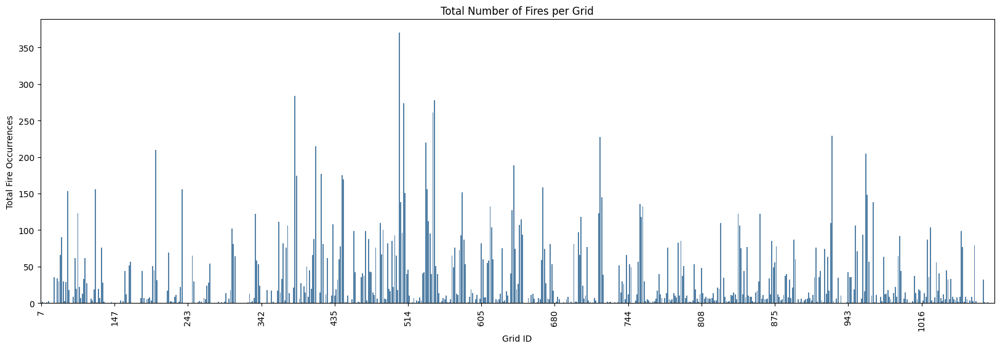

In [ ]:
import seaborn as sns

# number of fires per Grid_ID
fire_counts = merged_df.groupby("id")["fire_occurred"].sum().reset_index()

# Plot
plt.figure(figsize=(20, 6))
sns.barplot(x=fire_counts["id"], y=fire_counts["fire_occurred"], color="steelblue")

# ticks every 50 
tick_interval = 50  
plt.xticks(np.arange(0, len(fire_counts), step=tick_interval), rotation=90)

# Labels & Title
plt.xlabel("Grid ID")
plt.ylabel("Total Fire Occurrences")
plt.title("Total Number of Fires per Grid")

plt.show()

In [ ]:
# merged_df.isnull().sum()

id                           0
date                         0
fire_occurred                0
road                         0
powerline                    0
night_ligh                   0
mean_eleva                   0
max_elevat                   0
slope30                      0
north                        0
east                         0
south                        0
west                         0
wui                          0
agriNA                       0
grass                        0
forest                       0
shrub                        0
other                        0
agri                         0
geometry                     0
days_since_last_fire         0
wind_speed              107965
precipitation           107965
temperature             107965
no_prior_fire                0
dtype: int64

In [ ]:
# # old

# merged_df["date"] = pd.to_datetime(merged_df["date"])  # Ensure date is datetime
# merged_df = merged_df.sort_values(["id", "date"])

# ####################
# # 2) FIND FIRE EVENTS (INCLUDING NON-FIRE GRIDS)
# ####################
# event_list = []

# for grid, group in merged_df.groupby("id"):
#     fire_dates = group[group["fire_occurred"] == 1]["date"].tolist()  # All fire dates
#     start_time = group.iloc[0]["date"]  # Start from the first recorded date
#     last_date = group.iloc[-1]["date"]  # Last recorded date

#     if len(fire_dates) == 0:
#         #  No fires in this group → Create a single non-fire event covering the full range
#         event_list.append([grid, start_time, last_date, 0])
#         continue  # Move to the next grid

#     #  Create events for each fire
#     for fire_date in fire_dates:
#         event_list.append([grid, start_time, fire_date, 1])  # Fire event
#         start_time = fire_date  # Update start_time to the fire date

#     #  Add a final non-fire event after the last fire
#     if fire_dates[-1] != last_date:
#         event_list.append([grid, fire_dates[-1], last_date, 0])  # No fire event (censored)

# # Build 'event_df'
# event_df = pd.DataFrame(event_list, columns=["id", "start_time", "stop_time", "fire_occurred"])

# ###########################
# # 3) CONVERT DATES TO INTEGERS
# ###########################
# baseline_date = merged_df["date"].min()

# # Convert stop_time and start_time to 'days since baseline_date'
# event_df["stop_time"] = (event_df["stop_time"] - baseline_date).dt.days
# event_df["start_time"] = (event_df["start_time"] - baseline_date).dt.days

# ###########################
# # 4) SEASONAL FEATURES
# ###########################
# event_df["month"] = pd.to_datetime(
#     event_df["stop_time"], origin=baseline_date, unit="D"
# ).dt.month

# event_df["sin_month"] = np.sin(2 * np.pi * event_df["month"] / 12)
# event_df["cos_month"] = np.cos(2 * np.pi * event_df["month"] / 12)
# event_df.drop(columns=["month"], inplace=True)

# # Reconstruct stop_time as a datetime for merging
# event_df["stop_time_dt"] = pd.to_datetime(
#     event_df["stop_time"], origin=baseline_date, unit="D"
# )

# ###########################
# # 5) MERGE ALL COLUMNS FROM MERGED_DF
# ###########################
# # Ensure unique (id, date) pairs
# merged_unique = merged_df.drop_duplicates(subset=["id", "date"])

# # Merge everything from 'merged_unique' on (id, date)
# event_df = event_df.merge(
#     merged_unique, 
#     left_on=["id", "stop_time_dt"], 
#     right_on=["id", "date"], 
#     how="left"
# )

# # Optionally drop or rename duplicate columns
# event_df.drop(columns=["date", "stop_time_dt"], inplace=True, errors="ignore")
# event_df.loc[event_df["no_prior_fire"] == 1, "days_since_last_fire"] = 9999

# ###########################
# # 6) INSPECT THE RESULT
# ###########################
# print(event_df.head(10))

   id  start_time  stop_time  fire_occurred_x     sin_month  cos_month  \
0   7           0       5063                0 -5.000000e-01   0.866025   
1   8           0       1653                1 -5.000000e-01  -0.866025   
2   8        1653       3822                1 -5.000000e-01  -0.866025   
3   8        3822       5063                0 -5.000000e-01   0.866025   
4   9           0       5063                0 -5.000000e-01   0.866025   
5  36           0       5063                0 -5.000000e-01   0.866025   
6  37           0       4590                1 -8.660254e-01  -0.500000   
7  37        4590       5063                0 -5.000000e-01   0.866025   
8  38           0       3821                1  1.224647e-16  -1.000000   
9  38        3821       3832                1 -5.000000e-01  -0.866025   

   fire_occurred_y      road    powerline  night_ligh  ...    forest  shrub  \
0                0  7839.256     0.000000   37.439776  ...  0.000000    0.0   
1                1  3852.08

In [ ]:
event_df.shape

(20918, 32)

In [ ]:
event_df

,id,start_time,stop_time,fire_occurred_x,sin_month,cos_month,fire_occurred_y,road,powerline,night_ligh,...,other,agri,geometry,days_since_last_fire,wind_speed,precipitation,temperature,drought20,humidity,no_prior_fire
0,7,0,1730,0,-1.000000,-1.836970e-16,0,7839.256,0.0,37.439776,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,6.727868,0.000111,24.00987,0.035474,50.210552,1
1,7,1730,2655,0,0.866025,-5.000000e-01,0,7839.256,0.0,37.439776,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,8.676469,0.000173,16.952454,0.086509,79.29936,1
2,7,2655,5075,0,-0.500000,8.660254e-01,0,7839.256,0.0,37.439776,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,10.723253,0.0,14.984231,0.066749,61.877728,1
3,8,0,1665,1,-0.500000,-8.660254e-01,1,3852.088,0.0,28.750000,...,0.000000,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",0,17.403836,0.000701,24.079638,0.017228,57.28488,0
4,8,1666,3834,1,-0.500000,-8.660254e-01,1,3852.088,0.0,28.750000,...,0.000000,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",0,14.578476,0.000047,27.624141,0.005403,40.874073,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20913,1182,2756,3714,0,1.000000,6.123234e-17,0,6738.802,0.0,8.374424,...,0.059500,0.148500,"POLYGON ((1078536.4 4480191.603, 1078475.775 4...",9999,7.641443,0.000003,12.204058,0.022994,59.1255,1
20914,1182,3714,5075,0,-0.500000,8.660254e-01,0,6738.802,0.0,8.374424,...,0.059500,0.148500,"POLYGON ((1078536.4 4480191.603, 1078475.775 4...",9999,7.415085,0.000179,11.138249,0.073968,69.44275,1
20915,1183,0,21,0,0.500000,8.660254e-01,0,975.394,0.0,0.016234,...,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",9999,7.859377,0.000004,11.38188,0.009882,83.58904,1
20916,1183,21,3964,0,-0.500000,8.660254e-01,0,975.394,0.0,0.016234,...,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",9999,5.945819,0.007628,12.657994,0.043283,72.25599,1


In [ ]:
import numpy as np
import pandas as pd
from datetime import timedelta

merged_df["date"] = pd.to_datetime(merged_df["date"])
merged_df = merged_df.sort_values(["id", "date"])


event_list = []
num_intervals_nonfire = 3      # total intervals per grid
num_rand_splits      = num_intervals_nonfire - 1
np.random.seed(12)

for gid, group in merged_df.groupby("id"):
    start_time = group.iloc[0]["date"]
    last_date  = group.iloc[-1]["date"]
    span_days  = (last_date - start_time).days

    # 1) True fire dates in the interior
    fire_dates   = sorted(
        d for d in group.loc[group.fire_occurred == 1, "date"]
        if start_time < d < last_date
    )
    fire_offsets = [(d - start_time).days for d in fire_dates]

    # 2) Build “avoid” set so random splits aren’t on/next to a fire day
    avoid = set(fire_offsets) | {o-1 for o in fire_offsets} | {o+1 for o in fire_offsets}

    # 3) Candidate days for random splits
    rand_cands = [d for d in range(1, span_days) if d not in avoid]

    # 4) Always grab up to `num_rand_splits` random days (if available)
    if rand_cands:
        pick = min(num_rand_splits, len(rand_cands))
        rand_pts = sorted(int(x) for x in 
                          np.random.choice(rand_cands, size=pick, replace=False))
    else:
        rand_pts = []

    # 5) Combine fire offsets + random offsets
    split_days = sorted(set(fire_offsets + rand_pts))

    # 6) Turn those into absolute bounds [start, cuts…, end]
    bounds = [start_time] + [
        start_time + timedelta(days=d) for d in split_days
    ] + [last_date]

    # 7) Emit contiguous intervals, label by true fire‐end
    for i in range(len(bounds) - 1):
        s, e = bounds[i], bounds[i+1]
        label = 1 if e in fire_dates else 0
        event_list.append([gid, s, e, label])

# build the DataFrame
event_df = (
    pd.DataFrame(event_list, columns=["id", "start_time", "stop_time", "fire_occurred"])
      .sort_values(["id", "start_time"])
      .reset_index(drop=True)
)


baseline = merged_df["date"].min()
event_df["start_time"] = (event_df["start_time"] - baseline).dt.days
event_df["stop_time"]  = (event_df["stop_time"]  - baseline).dt.days


event_df["month"] = (
    pd.to_datetime(event_df["stop_time"], origin=baseline, unit="D")
      .dt.month
)
event_df["sin_month"] = np.sin(2 * np.pi * event_df["month"] / 12)
event_df["cos_month"] = np.cos(2 * np.pi * event_df["month"] / 12)
event_df.drop(columns=["month"], inplace=True)
event_df["stop_time_dt"] = (
    pd.to_datetime(event_df["stop_time"], origin=baseline, unit="D")
)


merged_unique = merged_df.drop_duplicates(subset=["id", "date"])
event_df = (
    event_df
      .merge(merged_unique,
             left_on=["id", "stop_time_dt"],
             right_on=["id", "date"],
             how="left")
      .drop(columns=["date", "stop_time_dt"], errors="ignore")
)

# fix‐up example
event_df.loc[event_df["no_prior_fire"] == 1, "days_since_last_fire"] = 9999
event_df_new  = event_df.copy()

print(event_df.head(10))


   id  start_time  stop_time  fire_occurred_x     sin_month  cos_month  \
0   7           0        835                0  8.660254e-01  -0.500000   
1   7         835       2000                0  1.224647e-16  -1.000000   
2   7        2000       5075                0 -5.000000e-01   0.866025   
3   8           0       1665                1 -5.000000e-01  -0.866025   
4   8        1665       2881                0 -5.000000e-01   0.866025   
5   8        2881       3834                1 -5.000000e-01  -0.866025   
6   8        3834       4540                0  1.224647e-16  -1.000000   
7   8        4540       5075                0 -5.000000e-01   0.866025   
8   9           0       1703                0 -8.660254e-01  -0.500000   
9   9        1703       4187                0  1.224647e-16  -1.000000   

   fire_occurred_y      road  powerline  night_ligh  ...  other      agri  \
0                0  7839.256        0.0   37.439776  ...    0.0  0.956463   
1                0  7839.256   

In [ ]:
event_df_new = event_df_new.sort_values(["id", "start_time"]).copy()

def fix_no_prior_fire(group):
    """
    For each grid (group), the first row is set to no_prior_fire=1.
    If we have already seen a fire in earlier rows, then no_prior_fire=0 for subsequent rows.
    """
    has_seen_fire = False
    for i in group.index:
        if i == group.index[0]:
            # first row in this grid
            group.loc[i, "no_prior_fire"] = 1
        else:
            # subsequent rows
            group.loc[i, "no_prior_fire"] = 0 if has_seen_fire else 1

        # If this row has a fire, update flag
        if group.loc[i, "fire_occurred_x"] == 1:
            has_seen_fire = True
    return group

# Apply the logic per grid 
event_df_new = event_df_new.groupby("id", group_keys=False).apply(fix_no_prior_fire)

# 
event_df_new = event_df_new.sort_values(["id", "start_time"]).reset_index(drop=True)
import numpy as np
import pandas as pd


# define no_prior_fire per id:
no_fire_map = (
    event_df_new.groupby("id")["fire_occurred_x"]
            .max()
            .apply(lambda x: 0 if x == 1 else 1)
)
event_df_new["no_prior_fire"] = event_df_new["id"].map(no_fire_map)


# ────────────────────────────────────────────────────────────────
def compute_days_since_fire_int(group):
    group = group.sort_values("start_time").copy()
    last_fire_stop = None
    days_list = []

    for _, row in group.iterrows():
        if last_fire_stop is None:
            # first interval: if no_prior_fire=1 we say “1 day”, else 0
            days = 1 if row["no_prior_fire"] == 1 else 0
        else:
            # subtract integer days
            days = row["stop_time"] - last_fire_stop

        days_list.append(days)

        # only update the “last fire” counter on actual fire events
        if row["fire_occurred_x"] == 1:
            last_fire_stop = row["stop_time"]

    group["days_since_last_fire"] = days_list
    return group

#
df = (
    event_df_new
      .groupby("id", group_keys=False)
      .apply(compute_days_since_fire_int)
      .reset_index(drop=True)
)

# 
df["days_since_last_fire"] = df["days_since_last_fire"].replace(0, 1)

# If you need to refresh no_prior_fire (it shouldn’t change), you can redo:
no_fire_map = (
    df.groupby("id")["fire_occurred_x"]
      .max()
      .apply(lambda x: 0 if x == 1 else 1)
)
df["no_prior_fire"] = df["id"].map(no_fire_map)

event_df_new = df  # overwrite your original

# 
event_df_new = event_df_new.groupby("id", group_keys=False).apply(fix_no_prior_fire)
event_df_new['duration'] = event_df_new["stop_time"] - event_df_new["start_time"]
print(event_df_new[[
    "id", "duration", "fire_occurred_x",
    "days_since_last_fire", "no_prior_fire"
]].head(30))


C:\Users\hclt0\AppData\Local\Temp\ipykernel_2664\2086100557.py:23: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  event_df_new = event_df_new.groupby("id", group_keys=False).apply(fix_no_prior_fire)
C:\Users\hclt0\AppData\Local\Temp\ipykernel_2664\2086100557.py:70: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  event_df_new


    id  duration  fire_occurred_x  days_since_last_fire  no_prior_fire
0    7      1730                0                     1              1
1    7       925                0                     1              1
2    7      2420                0                     1              1
3    8      1665                1                     1              1
4    8        88                0                    88              0
5    8       297                0                   385              0
6    8      1784                1                  2169              0
7    8      1241                0                  1241              0
8    9       842                0                     1              1
9    9      1495                0                     1              1
10   9      2738                0                     1              1
11  36      3285                0                     1              1
12  36       681                0                     1              1
13  36

C:\Users\hclt0\AppData\Local\Temp\ipykernel_2664\2086100557.py:94: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  event_df_new = event_df_new.groupby("id", group_keys=False).apply(fix_no_prior_fire)


In [ ]:
# assuming your full dataset is in 

# build the mask
leak_mask = event_df_new["days_since_last_fire"] == event_df_new["duration"]

# total number of “leaky” rows
n_leak = leak_mask.sum()
print(f"Number of rows where days_since_last_fire == duration: {n_leak}")

# breakdown of fire_occurred_x in those rows
vc = event_df_new.loc[leak_mask, "fire_occurred_x"].value_counts().sort_index()
print("fire_occurred_x value counts among those rows:")
print(vc)


Number of rows where days_since_last_fire == duration: 7775
fire_occurred_x value counts among those rows:
fire_occurred_x
0    2810
1    4965
Name: count, dtype: int64


In [ ]:
# event_df hvor der er taget hensyn til duration == days since fire
# og om hvor mange er ==0,1
import numpy as np
import pandas as pd
from datetime import timedelta

# 
# ────────────────────────────────────────────────────────────────
merged_df["date"] = pd.to_datetime(merged_df["date"])
merged_df = merged_df.sort_values(["id", "date"])

# ────────────────────────────────────────────────────────────────

event_list = []

np.random.seed(42)

for gid, group in merged_df.groupby("id"):
    start_time = group.iloc[0]["date"]
    last_date  = group.iloc[-1]["date"]
    span_days  = (last_date - start_time).days
    min_splits = 2
    multiplier = 0.4  # 1 split per ~2.5 fires
    max_splits = 30

    fire_count = group["fire_occurred"].sum()
    num_rand_splits = min(max_splits, max(min_splits, int(fire_count * multiplier)))


    # 1) True fire dates in the interior
    fire_dates   = sorted(
        d for d in group.loc[group.fire_occurred == 1, "date"]
        if start_time < d < last_date
    )
    fire_offsets = [(d - start_time).days for d in fire_dates]

    # 2) Build “avoid” set so random splits aren’t on/next to a fire day
    avoid = set(fire_offsets) | {o-1 for o in fire_offsets} | {o+1 for o in fire_offsets}

    # 3) Candidate days for random splits
    rand_cands = [d for d in range(1, span_days) if d not in avoid]

    # 4) Always grab up to `num_rand_splits` random days (if available)
    rand_pts = []

    if len(fire_offsets) >= 2:
        inter_fire_split_cnt = num_rand_splits // 2
        chosen_pairs = np.random.choice(
            range(len(fire_offsets) - 1),
            size=min(inter_fire_split_cnt, len(fire_offsets) - 1),
            replace=False
        )

        for i in chosen_pairs:
            start = fire_offsets[i]
            end   = fire_offsets[i + 1]
            mid_range = [d for d in range(start + 2, end - 1) if d not in avoid]
            if mid_range:
                rand_pts.append(np.random.choice(mid_range))

    # Fill remaining with general safe picks
    remaining = num_rand_splits - len(rand_pts)
    extra_rand = [d for d in rand_cands if d not in rand_pts]
    if extra_rand and remaining > 0:
        rand_pts += list(np.random.choice(extra_rand, size=min(remaining, len(extra_rand)), replace=False))

    rand_pts = sorted(set(int(x) for x in rand_pts))



    # 5) Combine fire offsets + random offsets
    split_days = sorted(set(fire_offsets + rand_pts))

    ####
    

    ####

    # 6) Turn those into absolute bounds [start, cuts…, end]
    bounds = [start_time] + [
        start_time + timedelta(days=int(d)) for d in split_days
    ] + [last_date]

    # 7) Emit contiguous intervals, label by true fire‐end
    for i in range(len(bounds) - 1):
        s, e = bounds[i], bounds[i+1]
        label = 1 if e in fire_dates else 0
        event_list.append([gid, s, e, label])

# build the DataFrame
event_df = (
    pd.DataFrame(event_list, columns=["id", "start_time", "stop_time", "fire_occurred"])
      .sort_values(["id", "start_time"])
      .reset_index(drop=True)
)

# 
baseline = merged_df["date"].min()
event_df["start_time"] = (event_df["start_time"] - baseline).dt.days
event_df["stop_time"]  = (event_df["stop_time"]  - baseline).dt.days

#
event_df["month"] = (
    pd.to_datetime(event_df["stop_time"], origin=baseline, unit="D")
      .dt.month
)
event_df["sin_month"] = np.sin(2 * np.pi * event_df["month"] / 12)
event_df["cos_month"] = np.cos(2 * np.pi * event_df["month"] / 12)
event_df.drop(columns=["month"], inplace=True)
event_df["stop_time_dt"] = (
    pd.to_datetime(event_df["stop_time"], origin=baseline, unit="D")
)

# 
merged_unique = merged_df.drop_duplicates(subset=["id", "date"])
event_df = (
    event_df
      .merge(merged_unique,
             left_on=["id", "stop_time_dt"],
             right_on=["id", "date"],
             how="left")
      .drop(columns=["date", "stop_time_dt"], errors="ignore")
)

# fix‐up example
event_df.loc[event_df["no_prior_fire"] == 1, "days_since_last_fire"] = 9999
event_df_new  = event_df.copy()
#
# ────────────────────────────────────────────────────────────────
print(event_df.head(10))


   id  start_time  stop_time  fire_occurred_x  sin_month     cos_month  \
0   7           0       1730                0  -1.000000 -1.836970e-16   
1   7        1730       2655                0   0.866025 -5.000000e-01   
2   7        2655       5075                0  -0.500000  8.660254e-01   
3   8           0       1665                1  -0.500000 -8.660254e-01   
4   8        1665       1753                0  -0.866025  5.000000e-01   
5   8        1753       2050                0  -0.866025 -5.000000e-01   
6   8        2050       3834                1  -0.500000 -8.660254e-01   
7   8        3834       5075                0  -0.500000  8.660254e-01   
8   9           0        842                0   0.866025 -5.000000e-01   
9   9         842       2337                0   0.500000 -8.660254e-01   

   fire_occurred_y      road  powerline  night_ligh  ...  other      agri  \
0                0  7839.256        0.0   37.439776  ...    0.0  0.956463   
1                0  7839.256   

In [128]:
event_df_new = event_df_new.dropna()


In [113]:
print(event_df.isna().sum())


id                        0
start_time                0
stop_time                 0
fire_occurred_x           0
sin_month                 0
cos_month                 0
fire_occurred_y           0
road                      0
powerline                 0
night_ligh                0
mean_eleva                0
max_elevat                0
slope30                   0
north                     0
east                      0
south                     0
west                      0
wui                       0
agriNA                    0
grass                     0
forest                    0
shrub                     0
other                     0
agri                      0
geometry                  0
days_since_last_fire      0
wind_speed              486
precipitation           486
temperature             486
drought20               486
humidity                487
no_prior_fire             0
dtype: int64


In [117]:
print(merged_df.isna().sum())

id                           0
date                         0
fire_occurred                0
road                         0
powerline                    0
night_ligh                   0
mean_eleva                   0
max_elevat                   0
slope30                      0
north                        0
east                         0
south                        0
west                         0
wui                          0
agriNA                       0
grass                        0
forest                       0
shrub                        0
other                        0
agri                         0
geometry                     0
days_since_last_fire         0
wind_speed              107965
precipitation           107965
temperature             107965
drought20               107965
humidity                108615
no_prior_fire                0
dtype: int64


In [120]:
climate_cols = ["wind_speed", "precipitation", "temperature", "drought20", "humidity"]
missing_climate = merged_df[merged_df[climate_cols].isna().any(axis=1)]
missing_dates = missing_climate["date"].drop_duplicates().sort_values()
print(missing_dates)


61      2007-01-31
120     2007-02-28
182     2007-03-31
243     2007-04-30
305     2007-05-31
           ...    
9951    2020-06-30
10013   2020-07-31
10075   2020-08-31
10136   2020-09-30
10198   2020-10-31
Name: date, Length: 167, dtype: datetime64[ns]


In [122]:
df_rhum.columnsclimate_cols = ["wind_speed", "precipitation", "temperature", "drought20", "humidity"]
missing_dates = merged_df.loc[merged_df[climate_cols].isna().any(axis=1), "date"].drop_duplicates()
df_rhum["date"] = pd.to_datetime(df_rhum["date"])  # ensure datetime format
rhum_dates = df_rhum["date"].drop_duplicates()
missing_not_in_rhum = missing_dates[~missing_dates.isin(rhum_dates)].sort_values()
print(missing_not_in_rhum)


C:\Users\hclt0\AppData\Local\Temp\ipykernel_2664\2993709731.py:1: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  df_rhum.columnsclimate_cols = ["wind_speed", "precipitation", "temperature", "drought20", "humidity"]


61      2007-01-31
120     2007-02-28
182     2007-03-31
243     2007-04-30
305     2007-05-31
           ...    
9951    2020-06-30
10013   2020-07-31
10075   2020-08-31
10136   2020-09-30
10198   2020-10-31
Name: date, Length: 167, dtype: datetime64[ns]


In [114]:
print(event_df[event_df.isna().any(axis=1)].head(10))


     id  start_time  stop_time  fire_occurred_x     sin_month     cos_month  \
19   38         782       3833                1  1.224647e-16 -1.000000e+00   
36   42         295        730                0 -2.449294e-16  1.000000e+00   
70   42        4631       4655                0 -1.000000e+00 -1.836970e-16   
147  70         495        669                0 -8.660254e-01  5.000000e-01   
151  70         852        911                0  1.224647e-16 -1.000000e+00   
176  70        3843       3864                1 -5.000000e-01 -8.660254e-01   
204  71         884        973                0 -8.660254e-01 -5.000000e-01   
246  72         265        942                0 -5.000000e-01 -8.660254e-01   
247  72         942       1580                0  8.660254e-01 -5.000000e-01   
264  72        4039       4048                0  5.000000e-01  8.660254e-01   

     fire_occurred_y       road     powerline  night_ligh  ...     other  \
19                 1   7596.073   4269.316158   19.975

In [72]:
event_df_new.columns

Index(['id', 'start_time', 'stop_time', 'fire_occurred_x', 'sin_month',
       'cos_month', 'fire_occurred_y', 'road', 'powerline', 'night_ligh',
       'mean_eleva', 'max_elevat', 'slope30', 'north', 'east', 'south', 'west',
       'wui', 'agriNA', 'grass', 'forest', 'shrub', 'other', 'agri',
       'geometry', 'days_since_last_fire', 'wind_speed', 'precipitation',
       'temperature', 'drought20', 'humidity', 'no_prior_fire', 'duration'],
      dtype='object')

In [ ]:
event_df_new.head(12)

,id,start_time,stop_time,fire_occurred_x,sin_month,cos_month,fire_occurred_y,road,powerline,night_ligh,...,other,agri,geometry,days_since_last_fire,wind_speed,precipitation,temperature,drought20,humidity,no_prior_fire
0,7,0,1730,0,-1.000000e+00,-1.836970e-16,0,7839.256,0.000000,37.439776,...,0.0,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,6.727868,0.000111,24.00987,0.035474,50.210552,1
1,7,1730,2655,0,8.660254e-01,-5.000000e-01,0,7839.256,0.000000,37.439776,...,0.0,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,8.676469,0.000173,16.952454,0.086509,79.29936,1
2,7,2655,5075,0,-5.000000e-01,8.660254e-01,0,7839.256,0.000000,37.439776,...,0.0,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,10.723253,0.0,14.984231,0.066749,61.877728,1
3,8,0,1665,1,-5.000000e-01,-8.660254e-01,1,3852.088,0.000000,28.750000,...,0.0,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",0,17.403836,0.000701,24.079638,0.017228,57.28488,0
4,8,1665,2049,0,-8.660254e-01,-5.000000e-01,0,3852.088,0.000000,28.750000,...,0.0,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",384,13.359744,0.000001,29.822837,0.01954,36.49546,0
5,8,2049,3834,1,-5.000000e-01,-8.660254e-01,1,3852.088,0.000000,28.750000,...,0.0,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",0,14.578476,0.000047,27.624141,0.005403,40.874073,0
6,8,3834,4822,0,1.000000e+00,6.123234e-17,0,3852.088,0.000000,28.750000,...,0.0,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",988,9.619513,0.002444,14.871996,0.066783,47.15659,0
7,8,4822,5075,0,-5.000000e-01,8.660254e-01,0,3852.088,0.000000,28.750000,...,0.0,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",1241,10.723253,0.0,14.984231,0.066749,61.877728,0
8,9,0,842,0,8.660254e-01,-5.000000e-01,0,0.000,0.000000,85.169300,...,0.0,0.000000,"POLYGON ((904298.107 4570138.235, 904062.748 4...",9999,7.43645,0.001853,15.748243,0.034709,76.2656,1
9,9,842,2337,0,5.000000e-01,-8.660254e-01,0,0.000,0.000000,85.169300,...,0.0,0.000000,"POLYGON ((904298.107 4570138.235, 904062.748 4...",9999,20.236194,0.001549,18.234898,0.047471,58.61839,1


In [ ]:
event_df_orig.head(12)

,id,start_time,stop_time,fire_occurred_x,sin_month,cos_month,fire_occurred_y,road,powerline,night_ligh,...,other,agri,geometry,days_since_last_fire,wind_speed,precipitation,temperature,drought20,humidity,no_prior_fire
0,7,0,1730,0,-1.000000e+00,-1.836970e-16,0,7839.256,0.000000,37.439776,...,0.0,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,6.727868,0.000111,24.00987,0.035474,50.210552,1
1,7,1730,2655,0,8.660254e-01,-5.000000e-01,0,7839.256,0.000000,37.439776,...,0.0,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,8.676469,0.000173,16.952454,0.086509,79.29936,1
2,7,2655,5075,0,-5.000000e-01,8.660254e-01,0,7839.256,0.000000,37.439776,...,0.0,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,10.723253,0.0,14.984231,0.066749,61.877728,1
3,8,0,1665,1,-5.000000e-01,-8.660254e-01,1,3852.088,0.000000,28.750000,...,0.0,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",0,17.403836,0.000701,24.079638,0.017228,57.28488,0
4,8,1666,3834,1,-5.000000e-01,-8.660254e-01,1,3852.088,0.000000,28.750000,...,0.0,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",0,14.578476,0.000047,27.624141,0.005403,40.874073,0
5,8,3835,5075,0,-5.000000e-01,8.660254e-01,0,3852.088,0.000000,28.750000,...,0.0,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",1241,10.723253,0.0,14.984231,0.066749,61.877728,0
6,8,3834,5075,0,-5.000000e-01,8.660254e-01,0,3852.088,0.000000,28.750000,...,0.0,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",1241,10.723253,0.0,14.984231,0.066749,61.877728,0
7,9,0,4180,0,1.224647e-16,-1.000000e+00,0,0.000,0.000000,85.169300,...,0.0,0.000000,"POLYGON ((904298.107 4570138.235, 904062.748 4...",9999,14.946784,0.000017,24.162123,0.005226,76.92378,1
8,9,4180,4741,0,-2.449294e-16,1.000000e+00,0,0.000,0.000000,85.169300,...,0.0,0.000000,"POLYGON ((904298.107 4570138.235, 904062.748 4...",9999,18.447331,0.000001,14.15509,0.152369,57.514465,1
9,9,4741,5075,0,-5.000000e-01,8.660254e-01,0,0.000,0.000000,85.169300,...,0.0,0.000000,"POLYGON ((904298.107 4570138.235, 904062.748 4...",9999,10.723253,0.0,14.984231,0.066749,61.337906,1


In [ ]:
event_df

,id,start_time,stop_time,fire_occurred_x,sin_month,cos_month,fire_occurred_y,road,powerline,night_ligh,...,other,agri,geometry,days_since_last_fire,wind_speed,precipitation,temperature,drought20,humidity,no_prior_fire
0,7,0,1730,0,-1.000000,-1.836970e-16,0,7839.256,0.0,37.439776,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,6.727868,0.000111,24.00987,0.035474,50.210552,1
1,7,1730,2655,0,0.866025,-5.000000e-01,0,7839.256,0.0,37.439776,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,8.676469,0.000173,16.952454,0.086509,79.29936,1
2,7,2655,5075,0,-0.500000,8.660254e-01,0,7839.256,0.0,37.439776,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,10.723253,0.0,14.984231,0.066749,61.877728,1
3,8,0,1665,1,-0.500000,-8.660254e-01,1,3852.088,0.0,28.750000,...,0.000000,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",0,17.403836,0.000701,24.079638,0.017228,57.28488,0
4,8,1665,2049,0,-0.866025,-5.000000e-01,0,3852.088,0.0,28.750000,...,0.000000,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",384,13.359744,0.000001,29.822837,0.01954,36.49546,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10242,1182,3427,4229,0,-0.500000,-8.660254e-01,0,6738.802,0.0,8.374424,...,0.059500,0.148500,"POLYGON ((1078536.4 4480191.603, 1078475.775 4...",9999,NaN,NaN,NaN,NaN,NaN,1
10243,1182,4229,5075,0,-0.500000,8.660254e-01,0,6738.802,0.0,8.374424,...,0.059500,0.148500,"POLYGON ((1078536.4 4480191.603, 1078475.775 4...",9999,7.415085,0.000179,11.138249,0.073968,69.44275,1
10244,1183,0,2277,0,1.000000,6.123234e-17,0,975.394,0.0,0.016234,...,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",9999,8.615846,0.005033,11.227081,0.13624,82.444336,1
10245,1183,2277,2601,0,0.866025,5.000000e-01,0,975.394,0.0,0.016234,...,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",9999,7.18984,0.001068,9.742148,0.111568,61.546825,1


In [ ]:
features_to_check = ["temperature", "humidity", "wind_speed", "precipitation", "drought20"]
results = {}

for feature in features_to_check:
    check = event_df[["id", "stop_time", feature]].copy()
    check = check.rename(columns={feature: f"{feature}_event"})
    check["stop_time_dt"] = pd.to_datetime(check["stop_time"], origin=baseline_date, unit="D")

    merged_check = check.merge(
        merged_df[["id", "date", feature]],
        left_on=["id", "stop_time_dt"],
        right_on=["id", "date"],
        how="left"
    ).drop(columns=["date", "stop_time_dt"])

    merged_check["match"] = merged_check[f"{feature}_event"] == merged_check[feature]
    results[feature] = merged_check["match"].all()


In [ ]:
print("Feature alignment status:")
for k, v in results.items():
    print(f"{k:15}: {'OK' if v else 'Mismatch'}")


Feature alignment status:
temperature    : ❌ Mismatch
humidity       : ❌ Mismatch
wind_speed     : ❌ Mismatch
precipitation  : ❌ Mismatch
drought20      : ❌ Mismatch


In [ ]:
bad_humidity = merged_check[merged_check["match"] == False]
print(bad_humidity.head())


    id  stop_time drought20_event drought20  match
14  36       3966        0.082318  0.085396  False
15  36       3966        0.082318  0.085396  False
18  36       3966        0.082318  0.085396  False
19  36       3966        0.082318  0.085396  False
22  36       3966        0.082318  0.085396  False


In [ ]:
print(event_df_new[['id', 'start_time', 'stop_time', 'drought20']].iloc[10:23,:])

    id  start_time  stop_time drought20
10   9        2337       5075  0.066749
11  36           0       3285  0.000203
12  36        3285       3966  0.082318
13  36        3966       5075  0.071577
14  37           0        505  0.116422
15  37         505       4602  0.061269
16  37        4602       4987   0.00552
17  37        4987       5075  0.071577
18  38           0        782  0.083051
19  38         782       2098  0.056976
20  38        2098       3833       NaN
21  38        3833       3844  0.005534
22  38        3844       3845   0.00497


In [ ]:
# merged_df

,id,date,fire_occurred,road,powerline,night_ligh,mean_eleva,max_elevat,slope30,north,...,other,agri,geometry,days_since_last_fire,wind_speed,precipitation,temperature,drought20,humidity,no_prior_fire
0,7,2007-01-01,0,7839.256,0.0,37.439776,2.851034,8.06000,0.003205,0.352508,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,12.098331,0.000008,13.296356,0.000008,80.6477,1
1,7,2007-01-02,0,7839.256,0.0,37.439776,2.851034,8.06000,0.003205,0.352508,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,27.020405,0.001057,10.956207,0.001064,71.75929,1
2,7,2007-01-03,0,7839.256,0.0,37.439776,2.851034,8.06000,0.003205,0.352508,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,9.338211,0.007309,10.217255,0.008373,45.51635,1
3,7,2007-01-04,0,7839.256,0.0,37.439776,2.851034,8.06000,0.003205,0.352508,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,4.976203,0.0,9.83905,0.008373,51.999493,1
4,7,2007-01-05,0,7839.256,0.0,37.439776,2.851034,8.06000,0.003205,0.352508,...,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,8.586748,0.000585,12.043304,0.008958,73.59878,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6668162,1183,2020-11-19,0,975.394,0.0,0.016234,1016.988750,1193.01001,0.038680,0.375345,...,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",9999,5.290413,0.000002,12.52475,0.014727,65.35175,1
6668163,1183,2020-11-20,0,975.394,0.0,0.016234,1016.988750,1193.01001,0.038680,0.375345,...,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",9999,13.244715,0.013993,6.471649,0.028715,88.595535,1
6668164,1183,2020-11-21,0,975.394,0.0,0.016234,1016.988750,1193.01001,0.038680,0.375345,...,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",9999,9.213771,0.0394,6.777863,0.068097,90.95159,1
6668165,1183,2020-11-22,0,975.394,0.0,0.016234,1016.988750,1193.01001,0.038680,0.375345,...,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",9999,4.543455,0.003702,12.348755,0.071695,74.54485,1


In [ ]:
# # Compute month feature
# merged_df["month"] = merged_df["date"].dt.month

# # Convert month to cyclic (sin and cos)
# merged_df["sin_month"] = np.sin(2 * np.pi * merged_df["month"] / 12)
# merged_df["cos_month"] = np.cos(2 * np.pi * merged_df["month"] / 12)

# # Drop raw month column
# merged_df.drop(columns=["month"], inplace=True)


# # 🔹 Step 1: Split "fire" and "no fire" cases
# df_fire = merged_df[merged_df["fire_occurred"] == 1]
# df_no_fire = merged_df[merged_df["fire_occurred"] == 0]

# def undersample_no_fire(group, min_no_fire=10):
#     num_fires = (group["fire_occurred"] == 1).sum()  # Count fire cases
#     num_no_fires = (group["fire_occurred"] == 0).sum()  # Count no fire cases
    
#     # If there are no fire cases, keep a small sample of "no fire" (default = 10)
#     if num_fires == 0:
#         return group.sample(n=min(min_no_fire, num_no_fires), random_state=42)

#     # Otherwise, sample the same number of "no fire" cases as fire cases
#     sampled_no_fire = group[group["fire_occurred"] == 0].sample(n=num_fires, random_state=42)
    
#     # Combine with the fire cases
#     return pd.concat([group[group["fire_occurred"] == 1], sampled_no_fire])

# # undersampling per grid
# df_balanced = df_no_fire.groupby("id").apply(undersample_no_fire).reset_index(drop=True)

# merged_balanced = pd.concat([df_fire, df_balanced])


# cutoff_date = pd.Timestamp("2017-01-01")
# train_df = merged_balanced[merged_balanced["date"] < cutoff_date]
# test_df = merged_balanced[merged_balanced["date"] >= cutoff_date]

# # Feature and target selection (Replace month with sin/cos encoding)
# feature_cols = [
#     "sin_month", "cos_month", "Temperature", "Humidity", "Precipitation", 
#     "Wind_Speed",  "road", "powerline", "night_ligh",
#     "mean_eleva", "max_elevat", "slope30", "north", "east", "south", "west",
#     "wui", "agriNA", "grass", "forest", "shrub", "other", "agri", "no_prior_fire"
# ]

# target_col = "fire_occurred"

# X_train = train_df[feature_cols]
# y_train = train_df[target_col]
# X_test = test_df[feature_cols]
# y_test = test_df[target_col]






C:\Users\hclt0\AppData\Local\Temp\ipykernel_17788\789552167.py:31: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df_balanced = df_no_fire.groupby("id").apply(undersample_no_fire).reset_index(drop=True)


KeyError: "['Temperature', 'Humidity', 'Precipitation', 'Wind_Speed'] not in index"

In [ ]:
# event_df

,id,start_time,stop_time,fire_occurred_x,sin_month,cos_month,fire_occurred_y,road,powerline,night_ligh,...,forest,shrub,other,agri,geometry,days_since_last_fire,wind_speed,precipitation,temperature,no_prior_fire
0,7,0,1687,0,-0.866025,-0.500000,0,7839.256,0.0,37.439776,...,0.000000,0.000000,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,11.537256,0.0,27.244293,1
1,7,1687,3375,0,0.866025,-0.500000,0,7839.256,0.0,37.439776,...,0.000000,0.000000,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,14.942154,0.002147,16.2471,1
2,7,3375,5063,0,-0.500000,0.866025,0,7839.256,0.0,37.439776,...,0.000000,0.000000,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,2.555013,0.0,15.756653,1
3,8,0,1653,1,-0.500000,-0.866025,1,3852.088,0.0,28.750000,...,0.065724,0.000000,0.000000,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",0,12.070243,0.000701,22.579254,0
4,8,1653,3822,1,-0.500000,-0.866025,1,3852.088,0.0,28.750000,...,0.065724,0.000000,0.000000,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",0,16.532825,0.00004,26.02359,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11415,1182,1687,3375,0,0.866025,-0.500000,0,6738.802,0.0,8.374424,...,0.283500,0.042500,0.059500,0.148500,"POLYGON ((1078536.4 4480191.603, 1078475.775 4...",9999,10.200566,0.001193,14.901398,1
11416,1182,3375,5063,0,-0.500000,0.866025,0,6738.802,0.0,8.374424,...,0.283500,0.042500,0.059500,0.148500,"POLYGON ((1078536.4 4480191.603, 1078475.775 4...",9999,4.644476,0.000179,11.793762,1
11417,1183,0,1687,0,-0.866025,-0.500000,0,975.394,0.0,0.016234,...,0.573333,0.030667,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",9999,5.639366,0.000234,26.11148,1
11418,1183,1687,3375,0,0.866025,-0.500000,0,975.394,0.0,0.016234,...,0.573333,0.030667,0.026667,0.000000,"POLYGON ((1078338.524 4475301.103, 1078579.399...",9999,9.805187,0.000989,14.475616,1


In [ ]:
# merged_df.head(289710)

,id,date,fire_occurred,road,powerline,night_ligh,mean_eleva,max_elevat,slope30,north,...,days_since_last_fire,Temperature,Dew_Point,Humidity,Pressure,Wind_Speed,Precipitation,no_prior_fire,sin_month,cos_month
0,7,2010-01-21,0,7839.256,0.000000,37.439776,2.851034,8.060000,0.003205,0.352508,...,9999,5.0,1.0,78.0,29.94,18.0,0.1,1,5.000000e-01,0.866025
1,7,2010-01-22,0,7839.256,0.000000,37.439776,2.851034,8.060000,0.003205,0.352508,...,9999,3.0,-0.0,82.0,30.06,15.0,0.5,1,5.000000e-01,0.866025
2,7,2010-01-23,0,7839.256,0.000000,37.439776,2.851034,8.060000,0.003205,0.352508,...,9999,3.0,-1.0,80.0,30.18,12.0,0.0,1,5.000000e-01,0.866025
3,7,2010-01-24,0,7839.256,0.000000,37.439776,2.851034,8.060000,0.003205,0.352508,...,9999,4.0,-0.0,80.0,30.24,5.0,0.0,1,5.000000e-01,0.866025
4,7,2010-01-25,0,7839.256,0.000000,37.439776,2.851034,8.060000,0.003205,0.352508,...,9999,5.0,1.0,85.0,30.27,9.0,0.6,1,5.000000e-01,0.866025
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
289705,206,2017-06-12,0,37825.915,22276.202518,76.549451,97.646534,406.880005,0.003156,0.148027,...,1059,25.0,9.0,51.0,30.00,5.0,0.0,0,1.224647e-16,-1.000000
289706,206,2017-06-13,1,37825.915,22276.202518,76.549451,97.646534,406.880005,0.003156,0.148027,...,0,26.0,12.0,56.0,29.97,7.0,0.0,0,1.224647e-16,-1.000000
289707,206,2017-06-13,1,37825.915,22276.202518,76.549451,97.646534,406.880005,0.003156,0.148027,...,0,26.0,12.0,56.0,29.97,7.0,0.0,0,1.224647e-16,-1.000000
289708,206,2017-06-14,0,37825.915,22276.202518,76.549451,97.646534,406.880005,0.003156,0.148027,...,1,26.0,14.0,60.0,29.97,8.0,0.5,0,1.224647e-16,-1.000000


In [ ]:
# train_df

,id,date,fire_occurred,road,powerline,night_ligh,mean_eleva,max_elevat,slope30,north,...,days_since_last_fire,Temperature,Dew_Point,Humidity,Pressure,Wind_Speed,Precipitation,no_prior_fire,sin_month,cos_month
4180,8,2011-07-24,1,3852.088,0.0,28.750000,1.770057,13.330000,0.000614,0.388589,...,0,20.0,13.0,73.0,29.71,17.0,0.2,0,-5.000000e-01,-8.660254e-01
32872,42,2010-08-02,1,9016.514,0.0,49.041018,40.940963,287.559998,0.010314,0.363440,...,0,26.0,15.0,64.0,29.97,4.0,0.0,0,-8.660254e-01,-5.000000e-01
32873,42,2010-08-02,1,9016.514,0.0,49.041018,40.940963,287.559998,0.010314,0.363440,...,0,26.0,15.0,64.0,29.97,4.0,0.0,0,-8.660254e-01,-5.000000e-01
32896,42,2010-08-25,1,9016.514,0.0,49.041018,40.940963,287.559998,0.010314,0.363440,...,0,27.0,16.0,65.0,29.97,6.0,0.0,0,-8.660254e-01,-5.000000e-01
32921,42,2010-09-19,1,9016.514,0.0,49.041018,40.940963,287.559998,0.010314,0.363440,...,0,21.0,15.0,79.0,29.88,12.0,1.6,0,-1.000000e+00,-1.836970e-16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6492,1183,2011-03-29,0,975.394,0.0,0.016234,1016.988750,1193.010010,0.038680,0.375345,...,9999,11.0,8.0,90.0,29.94,7.0,0.9,1,1.000000e+00,6.123234e-17
6493,1183,2010-07-23,0,975.394,0.0,0.016234,1016.988750,1193.010010,0.038680,0.375345,...,9999,31.0,16.0,56.0,29.94,8.0,0.0,1,-5.000000e-01,-8.660254e-01
6495,1183,2014-12-31,0,975.394,0.0,0.016234,1016.988750,1193.010010,0.038680,0.375345,...,9999,-3.0,-7.0,72.0,30.06,28.0,0.1,1,-2.449294e-16,1.000000e+00
6498,1183,2011-08-17,0,975.394,0.0,0.016234,1016.988750,1193.010010,0.038680,0.375345,...,9999,26.0,16.0,65.0,29.97,3.0,0.1,1,-8.660254e-01,-5.000000e-01


In [ ]:
# # Preprocessing pipeline (only numerical transformation)
# numeric_transformer = Pipeline(steps=[
#     ("imputer", SimpleImputer(strategy="mean")),  # Fill missing values
#     ("scaler", StandardScaler())  # Normalize features
# ])

# preprocessor = ColumnTransformer(transformers=[
#     ("num", numeric_transformer, feature_cols),
# ])

# # 🔹 Step 5: Train Random Forest model
# rf_model = Pipeline(steps=[
#     ("preprocessor", preprocessor),
#     ("classifier", RandomForestClassifier(n_estimators=100, random_state=42))
# ])

# rf_model.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['sin_month', 'cos_month',
                                                   'Temperature', 'Humidity',
                                                   'Precipitation',
                                                   'Wind_Speed', 'road',
                                                   'powerline', 'night_ligh',
                                                   'mean_eleva', 'max_elevat',
                                                   'slope30', 'north', 'east',
                                                   'south', 'west', 'wui',
                                                   'agriNA', 'grass', 'forest',
                                                   'shrub', 'other', 'agri',
                                                   'no_prior_fire'])])),
                ('classifier', RandomForestClassifier(random_state=42))])

In [ ]:
# len(merged_df)

2361386

In [ ]:
# 

In [ ]:
# # Step 3: Extract feature importances
# rf_feature_importance = rf_model.named_steps["classifier"].feature_importances_

# # Step 4: Get feature names
# feature_names = list(feature_cols)  # Ensure correct feature names

# # Step 5: Create a DataFrame for feature importances
# rf_importance_df = pd.DataFrame({"Feature": feature_names, "Importance": rf_feature_importance})
# rf_importance_df = rf_importance_df.sort_values(by="Importance", ascending=False)

# # Display feature importance table
# from IPython.display import display
# display(rf_importance_df)


,Feature,Importance
23,no_prior_fire,0.171652
3,Humidity,0.116594
0,sin_month,0.115250
2,Temperature,0.115088
1,cos_month,0.061731
4,Precipitation,0.053374
5,Wind_Speed,0.051715
10,max_elevat,0.028618
19,forest,0.028244
9,mean_eleva,0.026825


In [ ]:
# # Make predictions
# #  Evaluate model performance
# y_pred = rf_model.predict(X_test)
# y_pred_proba = rf_model.predict_proba(X_test)[:, 1]

# accuracy = accuracy_score(y_test, y_pred)
# roc_auc = roc_auc_score(y_test, y_pred_proba)

# print(f" Accuracy (Temporal Split): {accuracy:.4f}")
# print(f" ROC-AUC Score (Temporal Split): {roc_auc:.4f}")
# print("\nClassification Report:\n", classification_report(y_test, y_pred))

✅ Accuracy (Temporal Split): 0.8346
✅ ROC-AUC Score (Temporal Split): 0.9054

Classification Report:
               precision    recall  f1-score   support

           0       0.82      0.81      0.82      2170
           1       0.84      0.85      0.85      2600

    accuracy                           0.83      4770
   macro avg       0.83      0.83      0.83      4770
weighted avg       0.83      0.83      0.83      4770



In [ ]:
# merged_balanced

,id,date,fire_occurred,road,powerline,night_ligh,mean_eleva,max_elevat,slope30,north,...,days_since_last_fire,Temperature,Dew_Point,Humidity,Pressure,Wind_Speed,Precipitation,no_prior_fire,sin_month,cos_month
4180,8,2011-07-24,1,3852.088,0.000000,28.750000,1.770057,13.330000,0.000614,0.388589,...,0,20.0,13.0,73.0,29.71,17.0,0.2,0,-5.000000e-01,-0.866025
6349,8,2017-07-01,1,3852.088,0.000000,28.750000,1.770057,13.330000,0.000614,0.388589,...,0,26.0,9.0,48.0,29.91,8.0,0.0,0,-5.000000e-01,-0.866025
18010,37,2019-08-08,1,4626.213,6344.676669,20.191429,41.456366,137.389999,0.003129,0.339244,...,0,32.0,10.0,35.0,29.85,8.0,0.0,0,-8.660254e-01,-0.500000
20872,38,2017-06-30,1,7596.073,4269.316158,19.975510,51.356965,122.199997,0.001111,0.336789,...,0,29.0,12.0,53.0,29.85,8.0,0.0,0,1.224647e-16,-1.000000
20883,38,2017-07-11,1,7596.073,4269.316158,19.975510,51.356965,122.199997,0.001111,0.336789,...,0,30.0,8.0,37.0,29.97,12.0,0.0,0,-5.000000e-01,-0.866025
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6495,1183,2014-12-31,0,975.394,0.000000,0.016234,1016.988750,1193.010010,0.038680,0.375345,...,9999,-3.0,-7.0,72.0,30.06,28.0,0.1,1,-2.449294e-16,1.000000
6496,1183,2018-02-10,0,975.394,0.000000,0.016234,1016.988750,1193.010010,0.038680,0.375345,...,9999,7.0,2.0,77.0,29.71,17.0,0.0,1,8.660254e-01,0.500000
6497,1183,2018-04-29,0,975.394,0.000000,0.016234,1016.988750,1193.010010,0.038680,0.375345,...,9999,22.0,10.0,52.0,29.85,5.0,1.7,1,8.660254e-01,-0.500000
6498,1183,2011-08-17,0,975.394,0.000000,0.016234,1016.988750,1193.010010,0.038680,0.375345,...,9999,26.0,16.0,65.0,29.97,3.0,0.1,1,-8.660254e-01,-0.500000


Train set: 9325 rows
Buffer zone: 666 rows (excluded)
Test set: 3331 rows
Accuracy: 0.8967
ROC-AUC Score: 0.9663

Classification Report:
               precision    recall  f1-score   support

           0       0.89      0.93      0.91      1826
           1       0.91      0.86      0.88      1505

    accuracy                           0.90      3331
   macro avg       0.90      0.89      0.90      3331
weighted avg       0.90      0.90      0.90      3331



C:\Users\hclt0\AppData\Local\Temp\ipykernel_26392\3663315132.py:136: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()
C:\Users\hclt0\AppData\Local\Temp\ipykernel_26392\3663315132.py:136: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


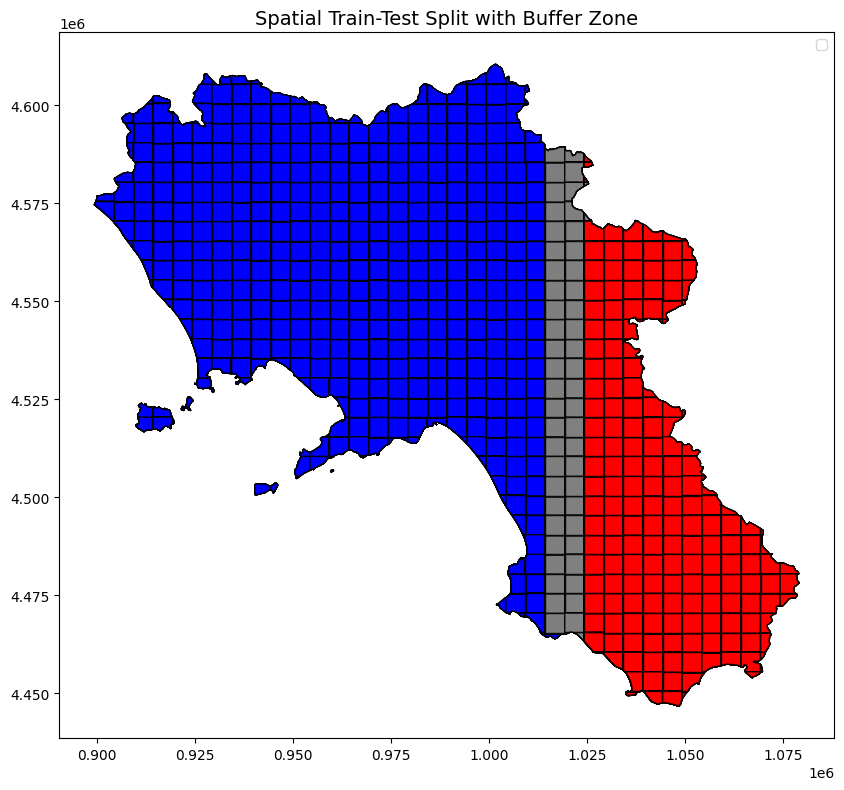

In [ ]:


# gdf = gpd.GeoDataFrame(merged_balanced, geometry=merged_balanced["geometry"])

# # Compute centroids
# gdf["centroid"] = gdf.geometry.centroid

# # Define kernel radius (e.g., 5000 meters)
# kernel_radius = 5000  
# sigma = 2500  # Controls Gaussian weight spread

# # Convert centroids to numpy array
# coords = np.array([(point.x, point.y) for point in gdf.geometry.centroid])
# tree = cKDTree(coords)


# # Initialize lists to store new features
# neighbor_mean_temp = []
# neighbor_fire_risk = []
# neighbor_road_density = []
# neighbor_powerline_density = []
# neighbor_nightlight_density = []

# # Compute neighbor-based features with kernel weighting
# for i, point in enumerate(coords):
#     indices = tree.query_ball_point(point, kernel_radius)
    
#     if len(indices) == 0:
#         # If no neighbors, retain original values
#         neighbor_mean_temp.append(gdf.iloc[i]["Temperature"])
#         neighbor_fire_risk.append(gdf.iloc[i]["fire_occurred"])
#         neighbor_road_density.append(gdf.iloc[i]["road"])  
#         neighbor_powerline_density.append(gdf.iloc[i]["powerline"])  
#         neighbor_nightlight_density.append(gdf.iloc[i]["night_ligh"])  
#         continue  
    
#     # Compute distances to neighbors
#     distances = np.linalg.norm(coords[indices] - point, axis=1)
    
#     # Apply Gaussian kernel weights
#     weights = np.exp(-(distances ** 2) / (2 * sigma ** 2))
#     weights /= np.sum(weights)  # Normalize weights

#     # Extract values from neighboring cells
#     temp_values = gdf.iloc[indices]["Temperature"].to_numpy()
#     fire_values = gdf.iloc[indices]["fire_occurred"].to_numpy()
#     road_values = gdf.iloc[indices]["road"].to_numpy()
#     powerline_values = gdf.iloc[indices]["powerline"].to_numpy()
#     nightlight_values = gdf.iloc[indices]["night_ligh"].to_numpy()

#     # Compute kernel-weighted averages
#     neighbor_mean_temp.append(np.sum(temp_values * weights))
#     neighbor_fire_risk.append(np.sum(fire_values * weights))
#     neighbor_road_density.append(np.sum(road_values * weights))
#     neighbor_powerline_density.append(np.sum(powerline_values * weights))
#     neighbor_nightlight_density.append(np.sum(nightlight_values * weights))

# # Add new smoothed features to DataFrame
# gdf["neighbor_mean_temp"] = neighbor_mean_temp
# gdf["neighbor_fire_risk"] = neighbor_fire_risk
# gdf["neighbor_road_density"] = neighbor_road_density
# gdf["neighbor_powerline_density"] = neighbor_powerline_density
# gdf["neighbor_nightlight_density"] = neighbor_nightlight_density

# # Extract centroid X-coordinate for sorting (West-East split)
# gdf["centroid_x"] = gdf["centroid"].apply(lambda point: point.x)
# gdf = gdf.sort_values(by="centroid_x", ascending=True)

# # Define proportions
# train_ratio = 0.70
# buffer_ratio = 0.05
# test_ratio = 1 - (train_ratio + buffer_ratio)

# total_rows = len(gdf)
# train_end = int(total_rows * train_ratio)
# buffer_end = int(total_rows * (train_ratio + buffer_ratio))

# train_df = gdf.iloc[:train_end]
# buffer_df = gdf.iloc[train_end:buffer_end]
# test_df = gdf.iloc[buffer_end:]

# feature_cols = ["sin_month", "cos_month", "Temperature", "Humidity", "Precipitation", 
#                 "Wind_Speed", "neighbor_fire_risk", "neighbor_road_density",
#                 "neighbor_powerline_density", "neighbor_nightlight_density",]
# target_col = "fire_occurred"

# X_train = train_df[feature_cols]
# y_train = train_df[target_col]
# X_test = test_df[feature_cols]
# y_test = test_df[target_col]

# print(f"Train set: {len(train_df)} rows")
# print(f"Buffer zone: {len(buffer_df)} rows (excluded)")
# print(f"Test set: {len(test_df)} rows")

# # Preprocessing pipeline
# numeric_transformer = Pipeline([
#     ("imputer", SimpleImputer(strategy="mean")),
#     ("scaler", StandardScaler())
# ])

# preprocessor = ColumnTransformer([
#     ("num", numeric_transformer, feature_cols)
# ])

# # Train Random Forest Model
# rf_model = Pipeline([
#     ("preprocessor", preprocessor),
#     ("classifier", RandomForestClassifier(n_estimators=100, random_state=42))
# ])

# rf_model.fit(X_train, y_train)
# y_pred = rf_model.predict(X_test)
# y_pred_proba = rf_model.predict_proba(X_test)[:, 1]

# accuracy = accuracy_score(y_test, y_pred)
# roc_auc = roc_auc_score(y_test, y_pred_proba)
# print(f"Accuracy: {accuracy:.4f}")
# print(f"ROC-AUC Score: {roc_auc:.4f}")
# print("\nClassification Report:\n", classification_report(y_test, y_pred))

# # Assign dataset labels
# gdf_plot = gdf.copy()
# gdf_plot["dataset"] = "Buffer"
# gdf_plot.iloc[:train_end, gdf_plot.columns.get_loc("dataset")] = "Train"
# gdf_plot.iloc[buffer_end:, gdf_plot.columns.get_loc("dataset")] = "Test"

# # Define colors
# colors = {"Train": "blue", "Buffer": "gray", "Test": "red"}

# # Plot Train, Buffer, and Test sets
# fig, ax = plt.subplots(figsize=(10, 10))
# for label, color in colors.items():
#     subset = gdf_plot[gdf_plot["dataset"] == label]
#     subset.plot(ax=ax, color=color, alpha=0.8, edgecolor="black", label=label)

# plt.title("Spatial Train-Test Split with Buffer Zone", fontsize=14)
# plt.legend()
# plt.show()


In [ ]:

# gdf = gpd.GeoDataFrame(event_df, geometry=event_df["geometry"])

# # Compute centroids
# gdf["centroid"] = gdf.geometry.centroid

# # Extract centroid Y-coordinate for sorting
# gdf["centroid_y"] = gdf["centroid"].apply(lambda point: point.y)

# # Sort by centroid Y-coordinate (latitude)
# gdf = gdf.sort_values(by="centroid_y", ascending=True)  # Sorting from South to North

# # Define proportions
# train_ratio = 0.70  # 70% for training
# buffer_ratio = 0.05  # 5% buffer zone (excluded)
# test_ratio = 1 - (train_ratio + buffer_ratio)  # Remaining 25% for testing

# # Compute row indices for splits
# total_rows = len(gdf)
# train_end = int(total_rows * train_ratio)  # Last row index for training
# buffer_end = int(total_rows * (train_ratio + buffer_ratio))  # Last row index for buffer zone

# # Create final datasets
# train_df = gdf.iloc[:train_end]  # Train dataset (bottom 70%)
# buffer_df = gdf.iloc[train_end:buffer_end]  # Buffer zone (excluded)
# test_df = gdf.iloc[buffer_end:]  # Test dataset (top 25%)

# # Extract features and target
# feature_cols = [
#     "sin_month", "cos_month", "Temperature", "Humidity", "Precipitation", 
#     "Wind_Speed"
# ]
# target_col = "fire_occurred_x"

# X_train = train_df[feature_cols]
# y_train = train_df[target_col]
# X_test = test_df[feature_cols]
# y_test = test_df[target_col]

# # Display dataset sizes
# print(f"Train set: {len(train_df)} rows")
# print(f"Buffer zone: {len(buffer_df)} rows (excluded)")
# print(f"Test set: {len(test_df)} rows")


KeyError: "['Temperature', 'Humidity', 'Precipitation', 'Wind_Speed'] not in index"

In [ ]:
# event_df["num_prior_fires"] = event_df.groupby("id").cumcount()
# epsilon = 1e-5  # avoid zero 
# event_df.loc[event_df["stop_time"] <= event_df["start_time"], "stop_time"] = \
#     event_df.loc[event_df["stop_time"] <= event_df["start_time"], "start_time"] + epsilon
# event_df

C:\Users\hclt0\AppData\Local\Temp\ipykernel_8836\2028656985.py:3: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[1297.00001 3798.00001 3810.00001 ... 3508.00001 4588.00001 4993.00001]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  event_df.loc[event_df["stop_time"] <= event_df["start_time"], "stop_time"] = \


,id,start_time,stop_time,fire_occurred_x,sin_month,cos_month,fire_occurred_y,road,powerline,night_ligh,...,shrub,other,agri,geometry,days_since_last_fire,wind_speed,precipitation,temperature,no_prior_fire,num_prior_fires
0,7,0,5063.0,0,-0.5,0.866025,0,7839.256,0.000000,37.439776,...,0.000000,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,2.555013,0.0,15.756653,1,0
1,8,0,1653.0,1,-0.5,-0.866025,1,3852.088,0.000000,28.750000,...,0.000000,0.000000,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",0,12.070243,0.000701,22.579254,0,0
2,8,1653,3822.0,1,-0.5,-0.866025,1,3852.088,0.000000,28.750000,...,0.000000,0.000000,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",0,16.532825,0.00004,26.02359,0,1
3,8,3822,5063.0,0,-0.5,0.866025,0,3852.088,0.000000,28.750000,...,0.000000,0.000000,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",1241,2.555013,0.0,15.756653,0,2
4,9,0,5063.0,0,-0.5,0.866025,0,0.000,0.000000,85.169300,...,0.000000,0.000000,0.000000,"POLYGON ((904298.107 4570138.235, 904062.748 4...",9999,2.555013,0.0,15.756653,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11147,1153,4984,5063.0,0,-0.5,0.866025,0,441.416,847.636084,0.467532,...,0.675676,0.054054,0.000000,"MULTIPOLYGON (((1070386.238 4460028.103, 10700...",79,1.803845,0.00021,14.227356,0,1
11148,1154,0,5063.0,0,-0.5,0.866025,0,0.000,0.000000,1.646934,...,0.000000,1.000000,0.000000,"POLYGON ((1069410.811 4455402.36, 1069372.311 ...",9999,1.803845,0.00021,14.227356,1,0
11149,1181,0,5063.0,0,-0.5,0.866025,0,3560.217,0.000000,0.530220,...,0.161209,0.065491,0.010076,"POLYGON ((1074298.107 4483156.468, 1074319.516...",9999,4.644476,0.000179,11.793762,1,0
11150,1182,0,5063.0,0,-0.5,0.866025,0,6738.802,0.000000,8.374424,...,0.042500,0.059500,0.148500,"POLYGON ((1078536.4 4480191.603, 1078475.775 4...",9999,4.644476,0.000179,11.793762,1,0


Doing more survival specific on event_df

In [ ]:
# event_df.columns

Index(['id', 'start_time', 'stop_time', 'fire_occurred_x', 'sin_month',
       'cos_month', 'fire_occurred_y', 'road', 'powerline', 'night_ligh',
       'mean_eleva', 'max_elevat', 'slope30', 'north', 'east', 'south', 'west',
       'wui', 'agriNA', 'grass', 'forest', 'shrub', 'other', 'agri',
       'geometry', 'days_since_last_fire', 'wind_speed', 'precipitation',
       'temperature', 'drought20', 'no_prior_fire'],
      dtype='object')

In [ ]:
# # count instances of NaN in df_prcp
# event_df.isnull().sum()

id                        0
start_time                0
stop_time                 0
fire_occurred_x           0
sin_month                 0
cos_month                 0
fire_occurred_y           0
road                      0
powerline                 0
night_ligh                0
mean_eleva                0
max_elevat                0
slope30                   0
north                     0
east                      0
south                     0
west                      0
wui                       0
agriNA                    0
grass                     0
forest                    0
shrub                     0
other                     0
agri                      0
geometry                  0
days_since_last_fire      0
wind_speed              337
precipitation           337
temperature             337
no_prior_fire             0
num_prior_fires           0
dtype: int64

In [ ]:
# event_df

,id,start_time,stop_time,fire_occurred_x,sin_month,cos_month,fire_occurred_y,road,powerline,night_ligh,...,shrub,other,agri,geometry,days_since_last_fire,wind_speed,precipitation,temperature,no_prior_fire,num_prior_fires
0,7,0,5063.0,0,-0.5,0.866025,0,7839.256,0.000000,37.439776,...,0.000000,0.000000,0.956463,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,2.555013,0.0,15.756653,1,0
1,8,0,1653.0,1,-0.5,-0.866025,1,3852.088,0.000000,28.750000,...,0.000000,0.000000,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",0,12.070243,0.000701,22.579254,0,0
2,8,1653,3822.0,1,-0.5,-0.866025,1,3852.088,0.000000,28.750000,...,0.000000,0.000000,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",0,16.532825,0.00004,26.02359,0,1
3,8,3822,5063.0,0,-0.5,0.866025,0,3852.088,0.000000,28.750000,...,0.000000,0.000000,0.826855,"POLYGON ((904298.107 4570403.859, 904062.748 4...",1241,2.555013,0.0,15.756653,0,2
4,9,0,5063.0,0,-0.5,0.866025,0,0.000,0.000000,85.169300,...,0.000000,0.000000,0.000000,"POLYGON ((904298.107 4570138.235, 904062.748 4...",9999,2.555013,0.0,15.756653,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11147,1153,4984,5063.0,0,-0.5,0.866025,0,441.416,847.636084,0.467532,...,0.675676,0.054054,0.000000,"MULTIPOLYGON (((1070386.238 4460028.103, 10700...",79,1.803845,0.00021,14.227356,0,1
11148,1154,0,5063.0,0,-0.5,0.866025,0,0.000,0.000000,1.646934,...,0.000000,1.000000,0.000000,"POLYGON ((1069410.811 4455402.36, 1069372.311 ...",9999,1.803845,0.00021,14.227356,1,0
11149,1181,0,5063.0,0,-0.5,0.866025,0,3560.217,0.000000,0.530220,...,0.161209,0.065491,0.010076,"POLYGON ((1074298.107 4483156.468, 1074319.516...",9999,4.644476,0.000179,11.793762,1,0
11150,1182,0,5063.0,0,-0.5,0.866025,0,6738.802,0.000000,8.374424,...,0.042500,0.059500,0.148500,"POLYGON ((1078536.4 4480191.603, 1078475.775 4...",9999,4.644476,0.000179,11.793762,1,0


In [ ]:
# event_df.isnull().sum()

id                        0
start_time                0
stop_time                 0
fire_occurred_x           0
sin_month                 0
cos_month                 0
fire_occurred_y           0
road                      0
powerline                 0
night_ligh                0
mean_eleva                0
max_elevat                0
slope30                   0
north                     0
east                      0
south                     0
west                      0
wui                       0
agriNA                    0
grass                     0
forest                    0
shrub                     0
other                     0
agri                      0
geometry                  0
days_since_last_fire      0
wind_speed              337
precipitation           337
temperature             337
no_prior_fire             0
dtype: int64

In [ ]:
# len(df_prcp['id'].unique())

650

In [ ]:
# merged_df

AttributeError: 'DataFrame' object has no attribute 'type'

In [ ]:
import pandas as pd

# Features to summarize
features_to_summarize = ["temperature", "wind_speed", "drought20", "humidity"]

# Make sure the features are numeric BEFORE doing any groupby/agg
for feat in features_to_summarize:
    merged_df[feat] = pd.to_numeric(merged_df[feat], errors='coerce')


# -----------------------------
# 1. OVERALL STATS PER GRID
# -----------------------------
summary_dfs = []

for feat in features_to_summarize:
    df_stats = (
        merged_df.groupby("id")[feat]
        .agg(["mean", "median", lambda x: x.quantile(0.25), lambda x: x.quantile(0.75)])
        .rename(columns={
            "mean": f"{feat}_mean",
            "median": f"{feat}_median",
            "<lambda_0>": f"{feat}_q25",
            "<lambda_1>": f"{feat}_q75"
        })
    )
    summary_dfs.append(df_stats)

df_summary_overall = pd.concat(summary_dfs, axis=1).reset_index()


#
merged_df["date"] = pd.to_datetime(merged_df["date"])
merged_df["month"] = merged_df["date"].dt.month

monthly_summaries = []

for feat in features_to_summarize:
    df_monthly = (
        merged_df.groupby(["id", "month"])[feat]
        .agg(["mean", "median", lambda x: x.quantile(0.25), lambda x: x.quantile(0.75)])
        .rename(columns={
            "mean": f"{feat}_mean",
            "median": f"{feat}_median",
            "<lambda_0>": f"{feat}_q25",
            "<lambda_1>": f"{feat}_q75"
        })
    )
    monthly_summaries.append(df_monthly)

df_summary_monthly = pd.concat(monthly_summaries, axis=1).reset_index()


In [ ]:
# df_summary_overall.to_csv("df_summary_overall.csv", index=False)
# df_summary_monthly.to_csv("df_summary_monthly.csv", index=False)


In [ ]:
# df_summary_overall

,id,temperature_mean,temperature_median,temperature_q25,temperature_q75,wind_speed_mean,wind_speed_median,wind_speed_q25,wind_speed_q75,drought20_mean,drought20_median,drought20_q25,drought20_q75,humidity_mean,humidity_median,humidity_q25,humidity_q75
0,7,18.741764,18.313140,13.281281,24.078766,10.963573,10.761469,6.960030,13.869173,0.066822,0.048947,0.018670,0.095562,64.778036,64.538345,56.432810,73.703920
1,8,18.741764,18.313140,13.281281,24.078766,10.963573,10.761469,6.960030,13.869173,0.066822,0.048947,0.018670,0.095562,64.869856,64.538345,56.432810,73.703920
2,9,18.741764,18.313140,13.281281,24.078766,10.963573,10.761469,6.960030,13.869173,0.066822,0.048947,0.018670,0.095562,64.880164,64.760780,56.216232,73.784325
3,36,18.760166,18.426940,12.528259,24.343414,6.311913,6.237432,4.258505,8.072367,0.074878,0.060528,0.026181,0.101597,59.356836,57.703102,47.204323,70.007470
4,37,18.760166,18.426940,12.528259,24.343414,6.311913,6.237432,4.258505,8.072367,0.074878,0.060528,0.026181,0.101597,61.345066,57.703102,47.204323,70.067390
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
645,1153,17.575573,17.450592,11.430420,23.074127,6.924575,6.646886,4.681779,8.873289,0.064543,0.056690,0.028425,0.087762,59.890372,57.956040,48.092740,69.444850
646,1154,17.575573,17.450592,11.430420,23.074127,6.924575,6.646886,4.681779,8.873289,0.064543,0.056690,0.028425,0.087762,59.888059,58.039693,48.224643,70.001665
647,1181,16.100017,16.186096,9.692077,21.984772,7.651456,7.112620,4.815347,10.200566,0.054789,0.049033,0.025779,0.075577,151.625668,57.108242,46.238777,71.214840
648,1182,16.100017,16.186096,9.692077,21.984772,7.651456,7.112620,4.815347,10.200566,0.054789,0.049033,0.025779,0.075577,59.170707,57.108242,46.238777,71.214840


In [ ]:
# df_summary.head(248)


,id,temperature_mean,temperature_median,temperature_q25,temperature_q75,wind_speed_mean,wind_speed_median,wind_speed_q25,wind_speed_q75,drought20_mean,drought20_median,drought20_q25,drought20_q75
0,7,18.346553,17.642548,12.959931,23.762482,10.964681,10.63798,6.894430,13.974710,0.068618,0.050696,0.017870,0.099426
1,8,18.346553,17.642548,12.959931,23.762482,10.964681,10.63798,6.894430,13.974710,0.068618,0.050696,0.017870,0.099426
2,9,18.346553,17.642548,12.959931,23.762482,10.964681,10.63798,6.894430,13.974710,0.068618,0.050696,0.017870,0.099426
3,36,18.306612,17.519073,12.248993,24.054565,6.266373,6.164939,4.215096,8.039902,0.075813,0.06018,0.025621,0.105907
4,37,18.306612,17.519073,12.248993,24.054565,6.266373,6.164939,4.215096,8.039902,0.075813,0.06018,0.025621,0.105907
...,...,...,...,...,...,...,...,...,...,...,...,...,...
243,507,17.046131,16.110138,10.901337,22.843414,8.715171,8.458592,5.639578,11.352094,0.067289,0.056148,0.025146,0.097842
244,508,17.522643,16.618256,11.420013,23.276703,8.604058,8.212073,5.882448,10.838267,0.075664,0.062075,0.025987,0.110217
245,509,17.418732,16.543488,11.386597,23.087921,8.605266,8.193485,5.882448,10.823117,0.076338,0.063035,0.026475,0.110584
246,510,17.416402,16.543488,11.386597,23.088104,8.606715,8.198896,5.882176,10.829885,0.076327,0.062991,0.026456,0.110584


In [ ]:
# hertil

In [ ]:
# event_df_new["geometry"] = event_df_new["geometry"].apply(lambda geom: geom.wkt if geom else None)

# # # Save as CSV
# event_df_new.to_csv("event_data_2007_2020_final1.csv", index=False)

In [ ]:
# event_df

,id,start_time,stop_time,fire_occurred_x,sin_month,cos_month,fire_occurred_y,road,powerline,night_ligh,...,geometry,days_since_last_fire,Temperature,Dew_Point,Humidity,Pressure,Wind_Speed,Precipitation,no_prior_fire,num_prior_fires
0,7,0,3630.0,0,-2.449294e-16,1.000000,0,7839.256,0.000000,37.439776,...,"POLYGON ((899646.736 4575403.859, 899886.983 4...",9999,4.0,-1.0,76.0,30.36,22.0,0.1,1,0
1,8,0,549.0,1,-5.000000e-01,-0.866025,1,3852.088,0.000000,28.750000,...,"POLYGON ((904298.107 4570403.859, 904062.748 4...",0,20.0,13.0,73.0,29.71,17.0,0.2,0,0
2,8,549,2718.0,1,-5.000000e-01,-0.866025,1,3852.088,0.000000,28.750000,...,"POLYGON ((904298.107 4570403.859, 904062.748 4...",0,26.0,9.0,48.0,29.91,8.0,0.0,0,1
3,8,2718,3630.0,0,-2.449294e-16,1.000000,0,3852.088,0.000000,28.750000,...,"POLYGON ((904298.107 4570403.859, 904062.748 4...",912,4.0,-1.0,76.0,30.36,22.0,0.1,0,2
4,9,0,3630.0,0,-2.449294e-16,1.000000,0,0.000,0.000000,85.169300,...,"POLYGON ((904298.107 4570138.235, 904062.748 4...",9999,4.0,-1.0,76.0,30.36,22.0,0.1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7466,1153,0,3630.0,0,-2.449294e-16,1.000000,0,441.416,847.636084,0.467532,...,"MULTIPOLYGON (((1070386.238 4460028.103, 10700...",9999,4.0,-1.0,76.0,30.36,22.0,0.1,1,0
7467,1154,0,3630.0,0,-2.449294e-16,1.000000,0,0.000,0.000000,1.646934,...,"POLYGON ((1069410.811 4455402.36, 1069372.311 ...",9999,4.0,-1.0,76.0,30.36,22.0,0.1,1,0
7468,1181,0,3630.0,0,-2.449294e-16,1.000000,0,3560.217,0.000000,0.530220,...,"POLYGON ((1074298.107 4483156.468, 1074319.516...",9999,4.0,-1.0,76.0,30.36,22.0,0.1,1,0
7469,1182,0,3630.0,0,-2.449294e-16,1.000000,0,6738.802,0.000000,8.374424,...,"POLYGON ((1078536.4 4480191.603, 1078475.775 4...",9999,4.0,-1.0,76.0,30.36,22.0,0.1,1,0


c:\Users\hclt0\anaconda3\envs\bachpro\lib\site-packages\lifelines\utils\__init__.py:1120: ConvergenceWarning: Column Humidity have very low variance when conditioned on death event present or not. This may harm convergence. This could be a form of 'complete separation'. For example, try the following code:

>>> events = df['fire_occurred_x'].astype(bool)
>>> print(df.loc[events, 'Humidity'].var())
>>> print(df.loc[~events, 'Humidity'].var())

A very low variance means that the column Humidity completely determines whether a subject dies or not. See https://stats.stackexchange.com/questions/11109/how-to-deal-with-perfect-separation-in-logistic-regression.

  warnings.warn(dedent(warning_text), ConvergenceWarning)
c:\Users\hclt0\anaconda3\envs\bachpro\lib\site-packages\lifelines\fitters\coxph_fitter.py:1614: ConvergenceWarning: Newton-Raphson failed to converge sufficiently. Please see the following tips in the lifelines documentation: https://lifelines.readthedocs.io/en/latest/Examples.

<lifelines.CoxPHFitter: fitted with 7471 total observations, 649 right-censored observations>
             duration col = 'stop_time'
                event col = 'fire_occurred_x'
              cluster col = 'id'
          robust variance = True
      baseline estimation = breslow
   number of observations = 7471
number of events observed = 6822
   partial log-likelihood = -49959.52
         time fit was run = 2025-03-11 11:14:11 UTC

---
                      coef exp(coef)  se(coef)  coef lower 95%  coef upper 95% exp(coef) lower 95% exp(coef) upper 95%
covariate                                                                                                             
start_time           -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
Temperature           0.04      1.04      0.01            0.02            0.05                1.02                1.05
Wind_Speed           -0.01      0.99      0.01           -0.02           -0.00                0.98                1.00
Humidity              0.03      1.04      0.00            0.03            0.04                1.03                1.04
Precipitation        -0.08      0.93      0.02           -0.12           -0.04                0.89                0.96
road                  0.00      1.00      0.00            0.00            0.00                1.00                1.00
powerline             0.00      1.00      0.00           -0.00            0.00                1.00                1.00
forest                0.79      2.21      0.22            0.36            1.23                1.43                3.42
grass                 0.78      2.19      0.51           -0.22            1.79                0.80                6.00
shrub                 1.72      5.57      0.37            1.00            2.44                2.72               11.42
agri                  1.21      3.34      0.26            0.69            1.72                2.00                5.57
days_since_last_fire -0.01      0.99      0.00           -0.01           -0.01                0.99                0.99

                      cmp to      z      p  -log2(p)
covariate                                           
start_time              0.00 -22.83 <0.005    380.83
Temperature             0.00   5.36 <0.005     23.53
Wind_Speed              0.00  -2.55   0.01      6.55
Humidity                0.00   8.63 <0.005     57.23
Precipitation           0.00  -3.78 <0.005     12.62
road                    0.00   3.85 <0.005     13.03
powerline               0.00   0.93   0.35      1.51
forest                  0.00   3.58 <0.005     11.48
grass                   0.00   1.52   0.13      2.97
shrub                   0.00   4.69 <0.005     18.47
agri                    0.00   4.62 <0.005     17.98
days_since_last_fire    0.00  -9.52 <0.005     68.94
---
Concordance = 0.89
Partial AIC = 99943.04
log-likelihood ratio test = 11298.77 on 12 df
-log2(p) of ll-ratio test = inf

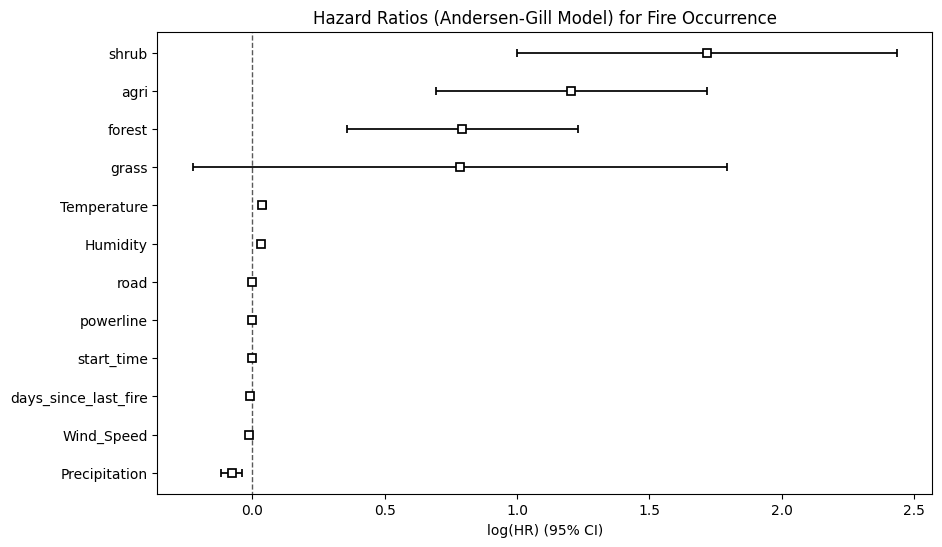

In [ ]:
# # Extract relevant spatial columns (Assuming 'geometry' exists as Polygon centroids)
# # event_df["geometry"] = event_df["geometry"].apply(wkt.loads)
# event_df["centroid_x"] = event_df["geometry"].apply(lambda g: g.centroid.x)
# event_df["centroid_y"] = event_df["geometry"].apply(lambda g: g.centroid.y)

# # Construct spatial tree for efficient neighbor lookup
# coords = np.vstack((event_df["centroid_x"], event_df["centroid_y"])).T
# tree = cKDTree(coords)

# # Step 2: Compute Fire Risk Based on True Spatial Neighbors
# neighbor_radius = 5000  # Adjust based on grid size (e.g., 5km)
# neighbor_indices = tree.query_ball_point(coords, neighbor_radius)

# # Compute mean fire occurrences in actual neighboring grids
# neighbor_risks = []
# for i, neighbors in enumerate(neighbor_indices):
#     # Remove self from neighbors
#     neighbors = [n for n in neighbors if n != i]

#     if len(neighbors) > 0:
#         # Compute fire density (fires per unit time)
#         total_fires = event_df.iloc[neighbors]["fire_occurred_x"].sum()
#         total_time = event_df.iloc[neighbors]["stop_time"].sum() - event_df.iloc[neighbors]["start_time"].sum()
        
#         if total_time > 0:
#             risk = total_fires / total_time  # Fire rate per time unit
#         else:
#             risk = 0  # Avoid division by zero
#     else:
#         risk = 0  # If no neighbors, default risk to 0

#     neighbor_risks.append(risk)

# # Assign the corrected spatial neighbor risk
# event_df["neighbor_fire_risk"] = neighbor_risks

# # Normalize risk to a reasonable scale
# event_df["neighbor_fire_risk"] = np.clip(event_df["neighbor_fire_risk"], 0, 1)

# ### 🔹 Step 2: Select Relevant Model Variables ###
# model_vars = [
#     "start_time", "stop_time", "fire_occurred_x", "id",
#     "Temperature", "Wind_Speed", "Humidity", "Precipitation",
#     "road", "powerline", "forest", "grass", "shrub", "agri",
#     "days_since_last_fire"
# ]

# # Exclude non-numeric columns
# df_model = event_df[model_vars].select_dtypes(include=[np.number])  # Removes 'geometry' and other non-numeric types

# ###  Step 3: Fit Andersen-Gill Model (Time-Dependent Cox) ###
# cph_ag = CoxPHFitter()
# cph_ag.fit(df_model, duration_col="stop_time", event_col="fire_occurred_x", cluster_col="id")

# # Print model summary
# cph_ag.print_summary()

# ###  Step 4: Visualize Hazard Ratios ###
# plt.figure(figsize=(10, 6))
# cph_ag.plot()
# plt.title("Hazard Ratios (Andersen-Gill Model) for Fire Occurrence")
# plt.show()

In [ ]:
# baseline_hazard = cox_model.baseline_hazard_
# coefficients = cox_model.params_

# def predict_hazard(new_data, time):
#     """
#     Predict the hazard for a given grid at a specific time.
#     new_data: DataFrame with the same structure as training data (without event/time)
#     time: Time point to compute the hazard
#     """
#     # Compute linear predictor
#     lin_pred = np.dot(new_data, coefficients)

#     # Get baseline hazard at the given time
#     h0_t = baseline_hazard.loc[time, 'baseline hazard']

#     # Compute hazard
#     hazard = h0_t * np.exp(lin_pred)
#     return hazard

# # Example usage:
# new_grid_data = np.array([time_since_last_fire, covariate1, covariate2])  # Adjust for your features
# time_horizon = 50  # Example time
# predicted_hazard = predict_hazard(new_grid_data, time_horizon)
# print(f"Predicted Hazard: {predicted_hazard}")

In [ ]:
# event_df.head(10)

,id,start_time,stop_time,fire_occurred_x,sin_month,cos_month,fire_occurred_y,road,powerline,night_ligh,...,Dew_Point,Humidity,Pressure,Wind_Speed,Precipitation,no_prior_fire,num_prior_fires,neighbor_fire_risk,centroid_x,centroid_y
0,7,0,3630.0,0,-2.449294e-16,1.000000,0,7839.256,0.000000,37.439776,...,-1.0,76.0,30.36,22.0,0.1,1,0,0.000551,902200.026094,4.576290e+06
1,8,0,549.0,1,-5.000000e-01,-0.866025,1,3852.088,0.000000,28.750000,...,13.0,73.0,29.71,17.0,0.2,0,0,0.000072,902460.879411,4.573657e+06
2,8,549,2718.0,1,-5.000000e-01,-0.866025,1,3852.088,0.000000,28.750000,...,9.0,48.0,29.91,8.0,0.0,0,1,0.000081,902460.879411,4.573657e+06
3,8,2718,3630.0,0,-2.449294e-16,1.000000,0,3852.088,0.000000,28.750000,...,-1.0,76.0,30.36,22.0,0.1,0,2,0.000147,902460.879411,4.573657e+06
4,9,0,3630.0,0,-2.449294e-16,1.000000,0,0.000,0.000000,85.169300,...,-1.0,76.0,30.36,22.0,0.1,1,0,0.002755,904219.654112,4.570315e+06
5,36,0,3630.0,0,-2.449294e-16,1.000000,0,4397.108,4156.552271,42.208791,...,-1.0,76.0,30.36,22.0,0.1,1,0,0.003444,908002.213112,4.596559e+06
6,37,0,3486.0,1,-8.660254e-01,-0.500000,1,4626.213,6344.676669,20.191429,...,10.0,35.0,29.85,8.0,0.0,0,0,0.002356,908528.972374,4.592889e+06
7,37,3486,3630.0,0,-2.449294e-16,1.000000,0,4626.213,6344.676669,20.191429,...,-1.0,76.0,30.36,22.0,0.1,0,1,0.001878,908528.972374,4.592889e+06
8,38,0,2717.0,1,1.224647e-16,-1.000000,1,7596.073,4269.316158,19.975510,...,12.0,53.0,29.85,8.0,0.0,0,0,0.002692,908634.915659,4.588643e+06
9,38,2717,2728.0,1,-5.000000e-01,-0.866025,1,7596.073,4269.316158,19.975510,...,8.0,37.0,29.97,12.0,0.0,0,1,0.002022,908634.915659,4.588643e+06


In [ ]:
# event_df['neighbor_fire_risk'].head(10)

0    0.000551
1    0.000072
2    0.000081
3    0.000147
4    0.002755
5    0.003444
6    0.002356
7    0.001878
8    0.002692
9    0.002022
Name: neighbor_fire_risk, dtype: float64

In [ ]:

# target_col = "fire_occurred_x"

# # Feature selection (excluding start_time, stop_time, geometry)
# feature_cols = [
#     "id", 
#     "sin_month", "cos_month", "road", "powerline", "night_ligh",
#     "mean_eleva", "max_elevat", "slope30", "north", "east", "south", "west",
#     "wui", "agriNA", "grass", "forest", "shrub", "other", "agri",
#     "Temperature", "Dew_Point", "Humidity", "Pressure", "Wind_Speed", 
#     "Precipitation", "no_prior_fire", "num_prior_fires"
# ]

# # 2) Filter DataFrame to these columns + target
# df_model = event_df[feature_cols + [target_col]].copy()
# df_model = df_model.dropna(subset=[target_col])  # Remove rows with missing target

# # 3) Train-test split based on **Grid ID**
# unique_ids = sorted(df_model["id"].unique())  # Sort to ensure consistency
# split_index = int(len(unique_ids) * 0.8)

# train_ids = unique_ids[:split_index]  # First 80% of grids for training
# test_ids = unique_ids[split_index:]  # Last 20% for testing

# train_df = df_model[df_model["id"].isin(train_ids)]
# test_df = df_model[df_model["id"].isin(test_ids)]

# # 4) Separate features and target
# X_train, y_train = train_df[feature_cols], train_df[target_col].astype(int)
# X_test, y_test = test_df[feature_cols], test_df[target_col].astype(int)

# # 5) Preprocessing pipeline
# # - Numerical: Mean imputation + Standard scaling
# # - Categorical ('id'): One-hot encoding
# categorical_cols = ["id"]  
# numeric_cols = list(set(feature_cols) - set(categorical_cols))

# numeric_transformer = Pipeline(steps=[
#     ("imputer", SimpleImputer(strategy="mean")),
#     ("scaler", StandardScaler())
# ])

# categorical_transformer = Pipeline(steps=[
#     ("encoder", OneHotEncoder(handle_unknown="ignore"))
# ])

# preprocessor = ColumnTransformer(
#     transformers=[
#         ("num", numeric_transformer, numeric_cols),
#         ("cat", categorical_transformer, categorical_cols),
#     ]
# )

# # 6) Logistic Regression pipeline
# logreg_pipeline = Pipeline(steps=[
#     ("preprocessor", preprocessor),
#     ("classifier", LogisticRegression(solver="liblinear"))  # Small/medium datasets
# ])

# # 7) Train the model
# logreg_pipeline.fit(X_train, y_train)

# # 8) Predictions & Evaluation
# y_pred = logreg_pipeline.predict(X_test)
# y_proba = logreg_pipeline.predict_proba(X_test)[:, 1]  # Probability for ROC AUC

# acc = accuracy_score(y_test, y_pred)
# prec = precision_score(y_test, y_pred)
# rec = recall_score(y_test, y_pred)
# auc = roc_auc_score(y_test, y_proba)

# print(f"Accuracy:  {acc:.3f}")
# print(f"Precision: {prec:.3f}")
# print(f"Recall:    {rec:.3f}")
# print(f"AUC-ROC:   {auc:.3f}")

# # 9) Extract feature importance
# lr_model = logreg_pipeline.named_steps["classifier"]

# # Extract feature names
# onehot = logreg_pipeline.named_steps["preprocessor"].named_transformers_["cat"]
# scaler = logreg_pipeline.named_steps["preprocessor"].named_transformers_["num"]

# numeric_feature_names = numeric_cols
# cat_feature_names = onehot.get_feature_names_out(categorical_cols)
# feature_names = list(numeric_feature_names) + list(cat_feature_names)

# # Extract coefficients
# coefficients = lr_model.coef_[0]

# # Store feature importances in DataFrame
# coef_df = pd.DataFrame({
#     "feature": feature_names,
#     "coef": coefficients
# })
# coef_df["abs_coef"] = coef_df["coef"].abs()

# # 10) Sort and display top features
# coef_df = coef_df.sort_values(by="abs_coef", ascending=False)
# print("\nTop features by absolute coefficient:")
# print(coef_df.head(15))

# # 11) Plot coefficients
# plt.figure(figsize=(8,6))
# plt.barh(coef_df["feature"], coef_df["coef"])
# plt.xlabel("Coefficient Value")
# plt.ylabel("Feature")
# plt.title("Logistic Regression Coefficients (Standardized)")
# plt.gca().invert_yaxis()  # Largest at top
# plt.show()


KeyError: "['sin_month', 'cos_month', 'num_prior_fires', 'fire_occurred_x'] not in index"

<Axes: xlabel='log(HR) (95% CI)'>

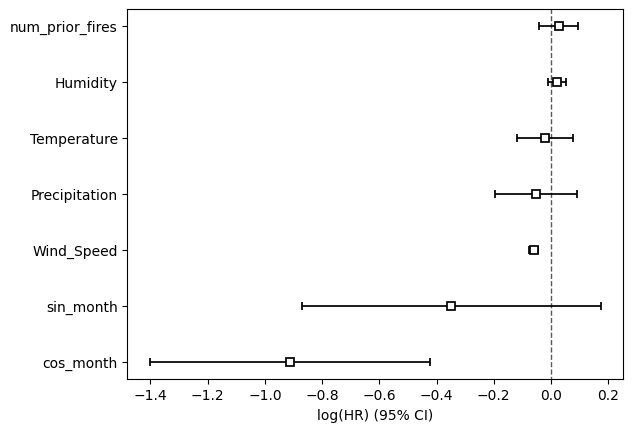

In [ ]:

# # Andersen-Gill Cox model
# cph = CoxPHFitter()
# cph.fit(event_df, duration_col="stop_time", event_col="fire_occurred", 
#         entry_col="start_time", cluster_col="Grid_ID") # s      ince we have multiple events per grid

# cph.plot()

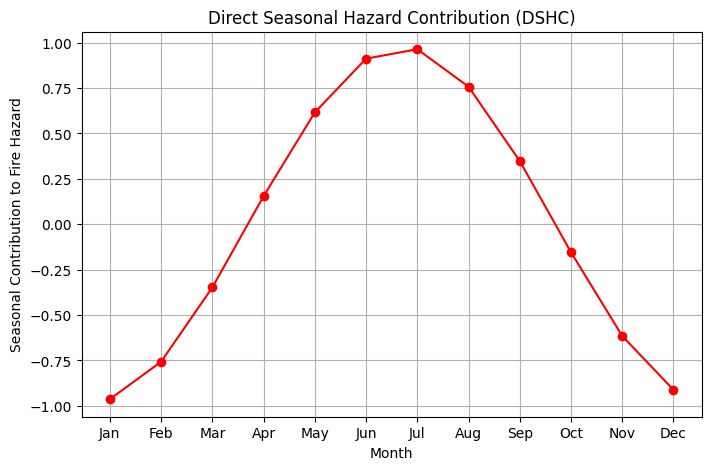

In [ ]:
# # month values
# months = np.arange(1, 13)
# sin_vals = np.sin(2 * np.pi * months / 12)
# cos_vals = np.cos(2 * np.pi * months / 12)

# # seasonal hazard 
# seasonal_hazard = (
#     cph.params_["sin_month"] * sin_vals + 
#     cph.params_["cos_month"] * cos_vals
# )

# # seasonal effect
# plt.figure(figsize=(8, 5))
# plt.plot(months, seasonal_hazard, marker="o", linestyle="-", color="red")
# plt.xlabel("Month")
# plt.ylabel("Seasonal Contribution to Fire Hazard")
# plt.title("Direct Seasonal Hazard Contribution (DSHC)")
# plt.xticks(months, ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"])
# plt.grid()
# plt.show()


In [ ]:
# from statsmodels.stats.outliers_influence import variance_inflation_factor

# X = event_df[["Temperature", "Humidity", "Wind_Speed", "Precipitation", "sin_month", "cos_month"]]
# vif_data = pd.DataFrame()
# vif_data["Variable"] = X.columns
# vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(len(X.columns))]
# print(vif_data)


        Variable        VIF
0    Temperature  22.707404
1       Humidity  14.302778
2     Wind_Speed   4.401540
3  Precipitation   1.172011
4      sin_month   3.751916
5      cos_month   3.646055


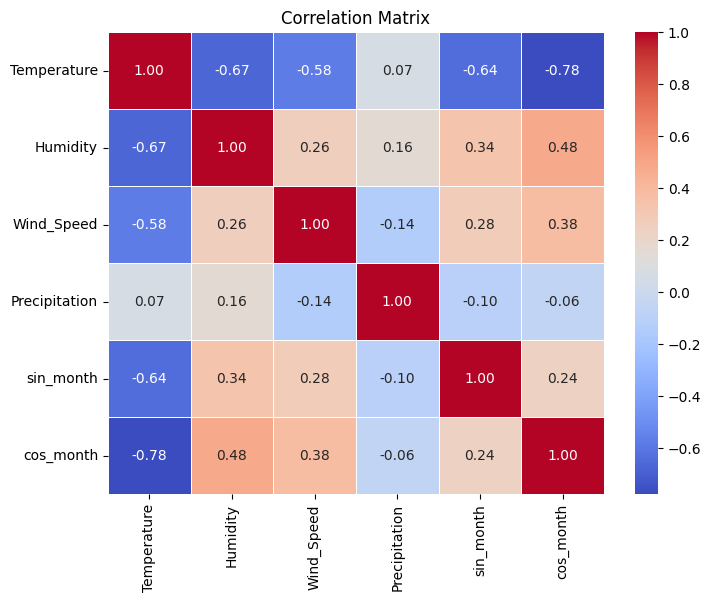

In [ ]:
# # correlation matrix
# corr_matrix = event_df[["Temperature", "Humidity", "Wind_Speed", "Precipitation", "sin_month", "cos_month"]].corr()

# # heatmap
# plt.figure(figsize=(8, 6))
# sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)
# plt.title("Correlation Matrix")
# plt.show()

In [ ]:
# # Predict expected time until the next wildfire for each observation
# event_df["expected_time_to_fire"] = cph.predict_expectation(event_df)

# # View predictions
# event_df[["Grid_ID", "expected_time_to_fire"]].groupby("Grid_ID").mean()


,expected_time_to_fire
Grid_ID,
25,2765.845454
56,2370.234379
57,2465.197147
60,2985.443893
61,2859.102903
...,...
1094,2959.926528
1096,2860.980963
1097,3049.596589


In [ ]:
# cph.check_assumptions(event_df, p_value_threshold=0.05)

,Grid_ID,start_time,stop_time,fire_occurred,Temperature,Humidity,Wind_Speed,Precipitation
0,25,0,549.00000,1,20.0,73.0,17.0,0.2
1,25,549,2718.00000,1,26.0,48.0,8.0,0.0
2,25,2718,3630.00000,0,4.0,76.0,22.0,0.1
3,56,0,193.00000,1,26.0,64.0,4.0,0.0
4,56,193,193.00001,1,26.0,64.0,4.0,0.0
...,...,...,...,...,...,...,...,...
7314,1097,1181,3630.00000,0,4.0,76.0,22.0,0.1
7315,1125,0,591.00000,1,27.0,62.0,9.0,0.0
7316,1125,591,3630.00000,0,4.0,76.0,22.0,0.1
7317,1127,0,2393.00000,1,25.0,68.0,12.0,0.0


In [ ]:
# cph = CoxPHFitter()
# cph.fit(event_df, duration_col="stop_time", event_col="fire_occurred", entry_col="start_time")
# cph.plot()

TypeError: unsupported operand type(s) for -: 'numpy.ndarray' and 'Timestamp'

In [ ]:
# event_df

,Grid_ID,start_time,stop_time,fire_occurred,Temperature,Humidity,Wind_Speed,Precipitation
0,25,2010-01-21,2011-07-24,1,20.0,73.0,17.0,0.2
1,25,2011-07-24,2017-07-01,1,26.0,48.0,8.0,0.0
2,25,2017-07-01,2019-12-30,0,4.0,76.0,22.0,0.1
3,56,2010-01-21,2010-08-02,1,26.0,64.0,4.0,0.0
4,56,2010-08-02,2010-08-02,1,26.0,64.0,4.0,0.0
...,...,...,...,...,...,...,...,...
7314,1097,2013-04-16,2019-12-30,0,4.0,76.0,22.0,0.1
7315,1125,2010-01-21,2011-09-04,1,27.0,62.0,9.0,0.0
7316,1125,2011-09-04,2019-12-30,0,4.0,76.0,22.0,0.1
7317,1127,2010-01-21,2016-08-10,1,25.0,68.0,12.0,0.0


In [ ]:
from tqdm import tqdm
import geopandas as gpd

# Ensure burn_areas is sorted by date
burn_areas = burn_areas.sort_values(by="data_inc")

# Load Campania region shapefile
campania_areas = gpd.read_file("fire-ignitions/campania/campania_region.shp")

# Initialize list for results
unburned_records = []

# Iterate through each burned area
for idx, row in tqdm(burn_areas.iterrows(), total=len(burn_areas), desc="Processing Unburned Areas"):
    burned_geometry = row.geometry
    date = row["data_inc"]

    # Compute unburned areas for this specific burned geometry
    unburned_area = gpd.overlay(campania_areas, gpd.GeoDataFrame(geometry=[burned_geometry]), how="difference")

    # Store results
    unburned_records.append({
        "date": date,
        "burned_geometry": burned_geometry,
        "unburned_geometry": unburned_area.geometry.union_all(),
    })

# Convert to GeoDataFrame
unburned_areas_df = gpd.GeoDataFrame(unburned_records, columns=["date", "burned_geometry", "unburned_geometry"])
unburned_areas_df.set_geometry("unburned_geometry", inplace=True)

# Save results
unburned_areas_df.to_file("unburned_areas_by_date.shp", driver="ESRI Shapefile")

Processing Unburned Areas:   0%|          | 0/9923 [00:00<?, ?it/s]C:\Users\hclt0\AppData\Local\Temp\ipykernel_24680\661411872.py:19: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:23032
Right CRS: None

  unburned_area = gpd.overlay(campania_areas, gpd.GeoDataFrame(geometry=[burned_geometry]), how="difference")
C:\Users\hclt0\AppData\Local\Temp\ipykernel_24680\661411872.py:19: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:23032
Right CRS: None

  unburned_area = gpd.overlay(campania_areas, gpd.GeoDataFrame(geometry=[burned_geometry]), how="difference")
Processing Unburned Areas:   0%|          | 2/9923 [00:00<09:02, 18.29it/s]C:\Users\hclt0\AppData\Local\Temp\ipykernel_24680\661411872.py:1

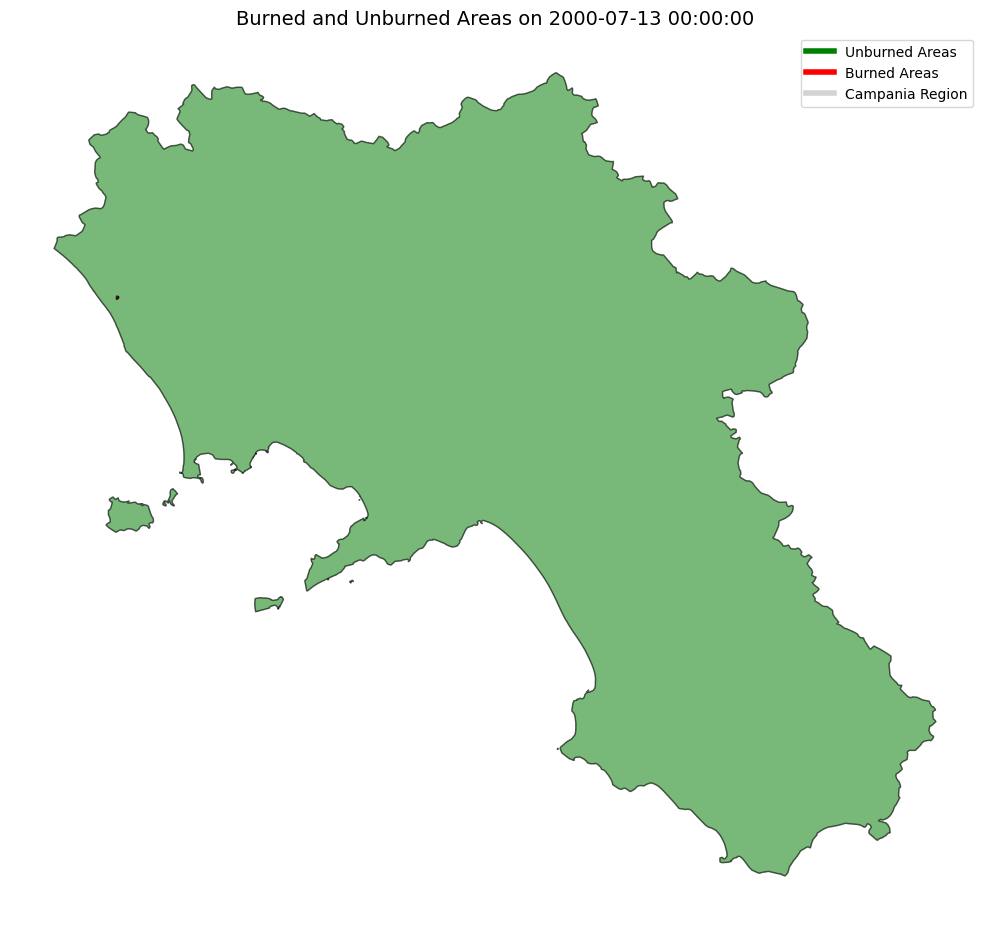

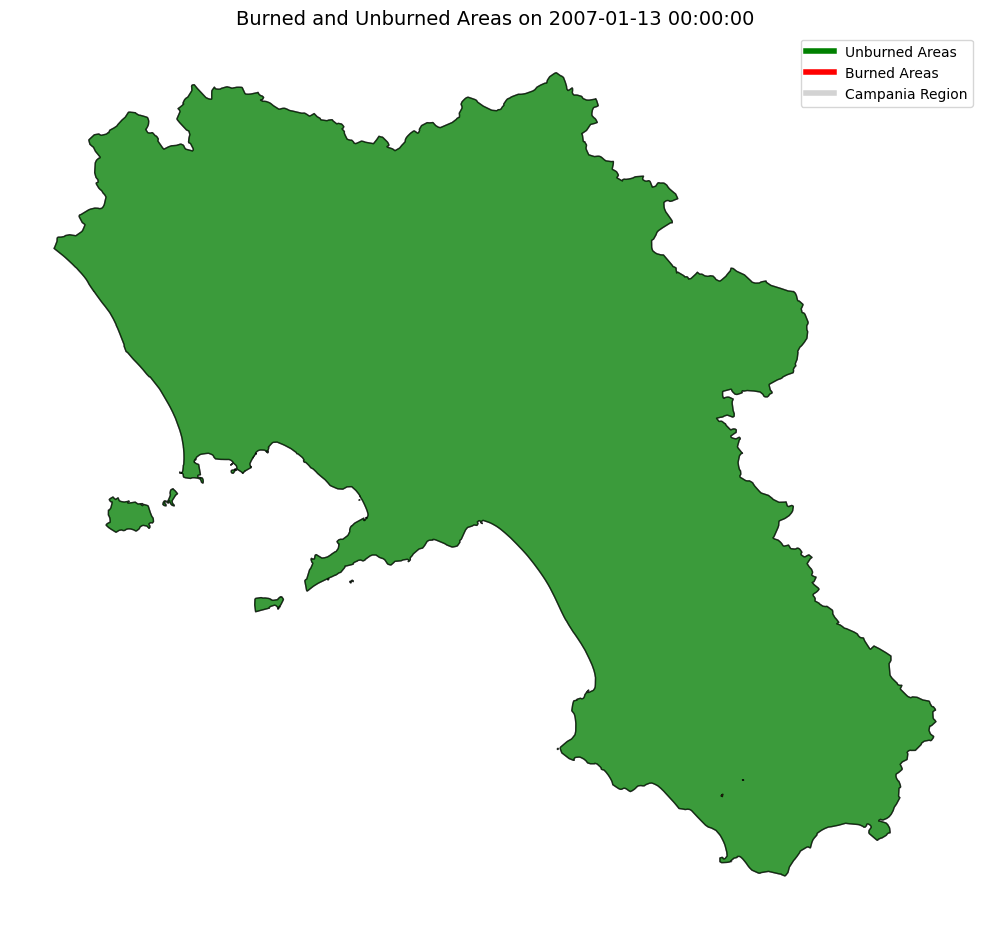

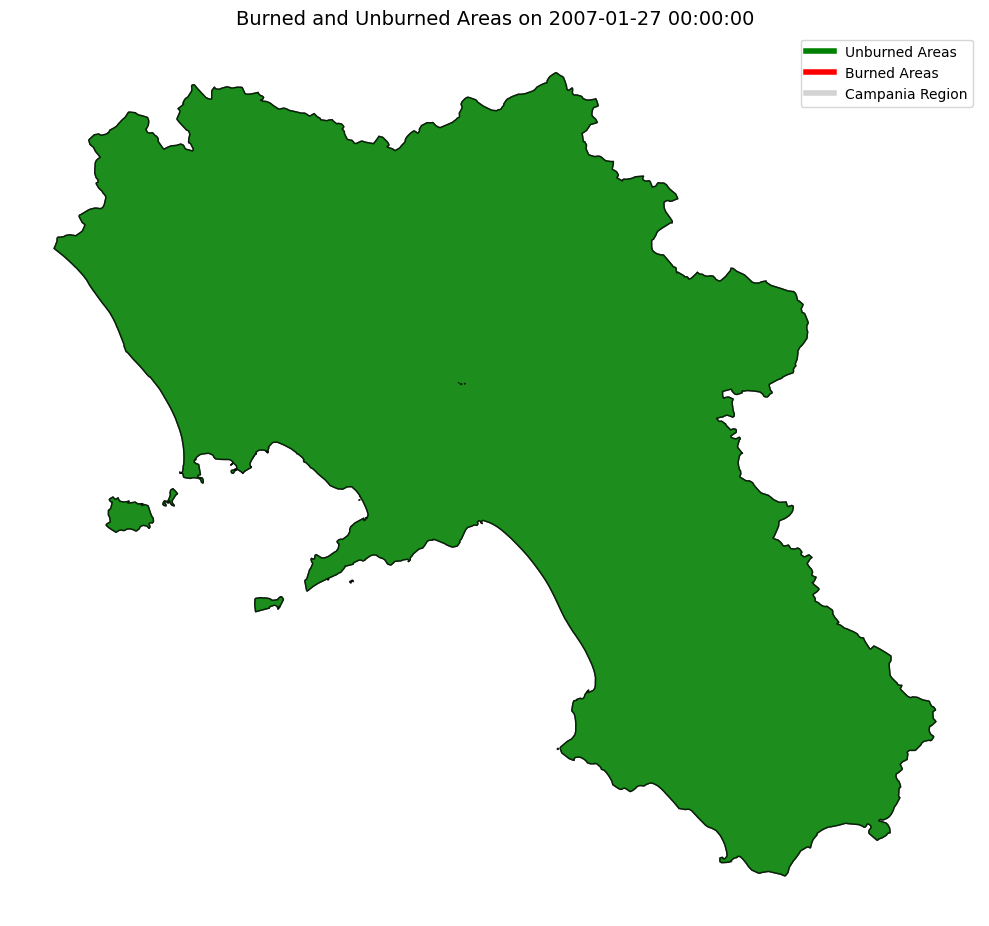

In [ ]:
# # Get the first 3 unique dates (sorted)
# first_3_dates = unburned_areas_df["data_inc"].sort_values().unique()[:3]

# # Create a plot for each date
# for date in first_3_dates:
#     # Filter burned and unburned areas for the current date
#     burned_today = unburned_areas_df[unburned_areas_df["data_inc"] == date]
#     unburned_today = unburned_areas_df[unburned_areas_df["date"] == date]

#     # Skip if no data exists for this date
#     if burned_today.empty or unburned_today.empty:
#         print(f"No data for date {date}. Skipping plot.")
#         continue

#     # Create a plot
#     fig, ax = plt.subplots(figsize=(10, 10))

#     # Plot Campania region as a base layer (for reference)
#     campania_areas.plot(ax=ax, color="lightgray", edgecolor="black", alpha=0.3, label="Campania Region")

#     # Plot unburned areas (green)
#     unburned_plot = unburned_today.plot(ax=ax, color="green", alpha=0.5, edgecolor="black", label="Unburned Areas")

#     # Plot burned areas (red)
#     burned_plot = burned_today.plot(ax=ax, color="red", alpha=0.7, edgecolor="black", markersize=100, label="Burned Areas")

#     # Create custom legend
#     from matplotlib.lines import Line2D  # For custom legend handles
#     legend_elements = [
#         Line2D([0], [0], color="green", lw=4, label="Unburned Areas"),
#         Line2D([0], [0], color="red", lw=4, label="Burned Areas"),
#         Line2D([0], [0], color="lightgray", lw=4, label="Campania Region")
#     ]

#     # Add legend
#     ax.legend(handles=legend_elements, loc="upper right")

#     # Customize the plot
#     ax.set_title(f"Burned and Unburned Areas on {date}", fontsize=14)
#     ax.set_axis_off()  # Remove axes for cleaner visualization

#     # Show plot
#     plt.tight_layout()
#     plt.show()

In [ ]:
# burned_area_union = unary_union(unburned_areas_df['geometry'])
# burned_area_union

In [ ]:
# unburned_area = study_area.difference(burned_area_union)
# unburned_area

I need to fit a cox model onto expanded_df, we want to include areas that haven't burned as censored data to avoid bias

In [ ]:
# # Compute sine and cosine terms for seasonality
# expanded_df["sin_day"] = np.sin(2 * np.pi * expanded_df["date"].dt.dayofyear / 365)
# expanded_df["cos_day"] = np.cos(2 * np.pi * expanded_df["date"].dt.dayofyear / 365)

# # Update the Cox model formula
# cph.fit(expanded_df, duration_col="days_since_last_fire", event_col="fire_occurred", 
#         formula="Temperature + Humidity + Wind_Speed + Dew_Point + Pressure + Precipitation + sin_day + cos_day")

# # Print the updated summary
# cph.print_summary()

<lifelines.CoxPHFitter: fitted with 8653 total observations, 2546 right-censored observations>
             duration col = 'days_since_last_fire'
                event col = 'fire_occurred'
      baseline estimation = breslow
   number of observations = 8653
number of events observed = 6107
   partial log-likelihood = -50666.24
         time fit was run = 2025-02-17 13:42:39 UTC

---
               coef exp(coef)  se(coef)  coef lower 95%  coef upper 95% exp(coef) lower 95% exp(coef) upper 95%
covariate                                                                                                      
Temperature    0.03      1.03      0.01            0.01            0.05                1.01                1.06
Humidity      -0.01      0.99      0.00           -0.02           -0.00                0.98                1.00
Wind_Speed     0.02      1.02      0.00            0.01            0.03                1.01                1.03
Dew_Point     -0.01      0.99      0.01           -0.04            0.01                0.96                1.01
Pressure       1.27      3.57      0.12            1.04            1.51                2.82                4.53
Precipitation -0.05      0.95      0.01           -0.07           -0.03                0.94                0.97
sin_day       -0.53      0.59      0.03           -0.60           -0.46                0.55                0.63
cos_day       -0.61      0.55      0.05           -0.71           -0.50                0.49                0.61

               cmp to      z      p  -log2(p)
covariate                                    
Temperature      0.00   3.14 <0.005      9.20
Humidity         0.00  -2.94 <0.005      8.23
Wind_Speed       0.00   5.48 <0.005     24.46
Dew_Point        0.00  -1.18   0.24      2.08
Pressure         0.00  10.52 <0.005     83.51
Precipitation    0.00  -6.14 <0.005     30.16
sin_day          0.00 -15.07 <0.005    168.13
cos_day          0.00 -11.18 <0.005     93.95
---
Concordance = 0.89
Partial AIC = 101348.48
log-likelihood ratio test = 3412.20 on 8 df
-log2(p) of ll-ratio test = inf

In [ ]:
# survival_df

,date,fire_occurred,days_since_last_fire,Temperature,Dew_Point,Humidity,Pressure,Wind_Speed,Precipitation,sin_day,cos_day
1,2010-01-02,0,1,9,6,84,29.62,24,7.0,3.442161e-02,0.999407
2,2010-01-03,0,2,4,1,78,30.03,13,0.2,5.161967e-02,0.998667
3,2010-01-04,0,3,4,2,89,30.00,10,4.2,6.880243e-02,0.997630
4,2010-01-05,0,4,11,8,91,29.65,12,0.6,8.596480e-02,0.996298
5,2010-01-06,0,5,10,9,93,29.56,23,4.8,1.031017e-01,0.994671
...,...,...,...,...,...,...,...,...,...,...,...
3647,2019-12-27,0,58,8,-1,63,30.18,5,0.0,-6.880243e-02,0.997630
3648,2019-12-28,0,59,5,0,74,30.27,24,2.3,-5.161967e-02,0.998667
3649,2019-12-29,0,60,4,0,76,30.36,24,0.2,-3.442161e-02,0.999407
3650,2019-12-30,1,0,4,-1,76,30.36,22,0.1,-1.721336e-02,0.999852


In [ ]:
# survival_df['event'] =survival_df['time_to_fire'].notnull().astype(int)

KeyError: 'time_to_fire'

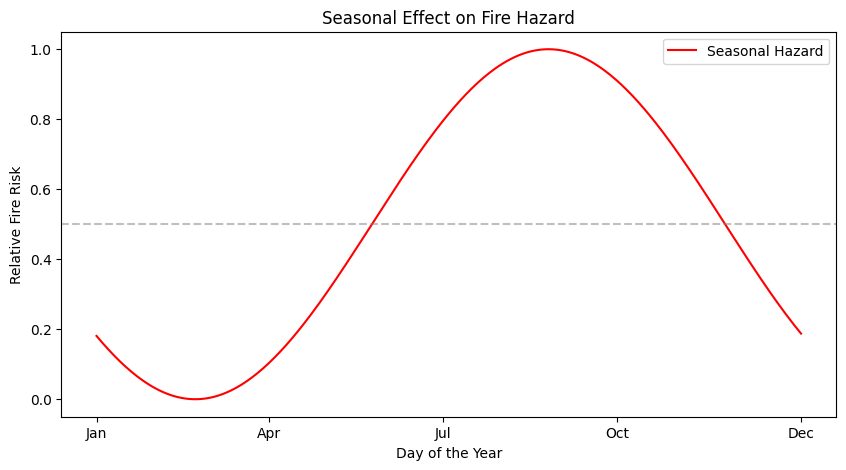

In [ ]:
# # Direct Seasonal Hazard Contribution

# coef_sin = cph.params_["sin_day"]
# coef_cos = cph.params_["cos_day"]

# # Generate values for each day of the year (1 to 365)
# days = np.arange(1, 366)

# # Compute the seasonal hazard contribution
# hazard_seasonal = coef_sin * np.sin(2 * np.pi * days / 365) + coef_cos * np.cos(2 * np.pi * days / 365)

# # Normalize to show relative risk (optional)
# hazard_seasonal = (hazard_seasonal - np.min(hazard_seasonal)) / (np.max(hazard_seasonal) - np.min(hazard_seasonal))

# # Plot the seasonal hazard function
# plt.figure(figsize=(10, 5))
# plt.plot(days, hazard_seasonal, label="Seasonal Hazard", color="red")
# plt.axhline(y=0.5, linestyle="--", color="gray", alpha=0.5)  # Reference line
# plt.xlabel("Day of the Year")
# plt.ylabel("Relative Fire Risk")
# plt.title("Seasonal Effect on Fire Hazard")
# plt.xticks([1, 90, 180, 270, 365], ["Jan", "Apr", "Jul", "Oct", "Dec"])  # Label months
# plt.legend()
# plt.show()

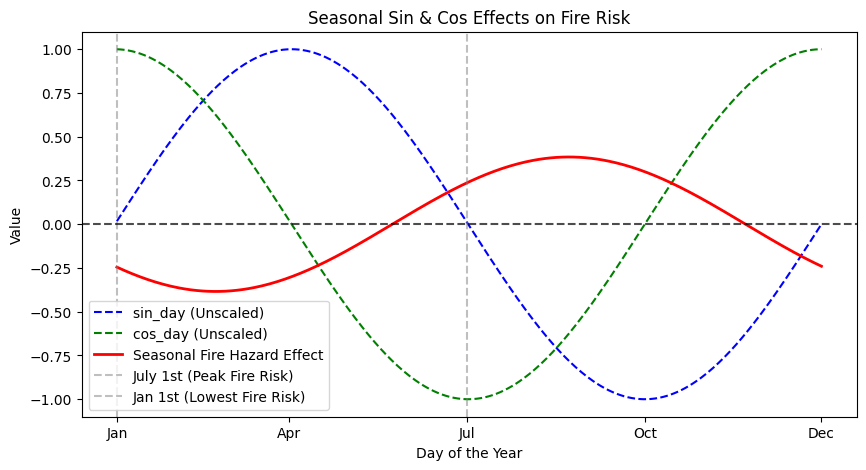

In [ ]:
# # The Full Fire Hazard Function (Relative Fire Risk)


# # Generate days of the year (1 to 365)
# days = np.arange(1, 366)

# # Compute sin and cos values
# sin_values = np.sin(2 * np.pi * days / 365)
# cos_values = np.cos(2 * np.pi * days / 365)

# # Apply the negative coefficients from your Cox model
# beta_sin = -0.30  # Coefficient for sin_day
# beta_cos = -0.24  # Coefficient for cos_day

# # Compute the seasonal effect
# seasonal_effect = beta_sin * sin_values + beta_cos * cos_values

# # Plotting
# plt.figure(figsize=(10, 5))
# plt.plot(days, sin_values, label="sin_day (Unscaled)", linestyle="dashed", color="blue")
# plt.plot(days, cos_values, label="cos_day (Unscaled)", linestyle="dashed", color="green")
# plt.plot(days, seasonal_effect, label="Seasonal Fire Hazard Effect", color="red", linewidth=2)

# # Mark key points
# plt.axvline(x=182, linestyle="--", color="gray", alpha=0.5, label="July 1st (Peak Fire Risk)")
# plt.axvline(x=1, linestyle="--", color="gray", alpha=0.5, label="Jan 1st (Lowest Fire Risk)")

# # Labels and title
# plt.xlabel("Day of the Year")
# plt.ylabel("Value")
# plt.title("Seasonal Sin & Cos Effects on Fire Risk")
# plt.xticks([1, 90, 182, 274, 365], ["Jan", "Apr", "Jul", "Oct", "Dec"])  # Label months
# plt.axhline(y=0, linestyle="--", color="black", alpha=0.7)  # Zero line
# plt.legend()
# plt.show()

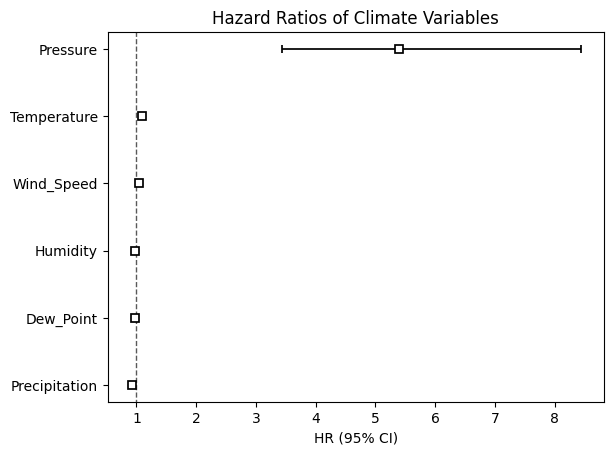

In [ ]:
# cph.plot(hazard_ratios=True)
# plt.title("Hazard Ratios of Climate Variables")
# plt.show()

c:\Users\hclt0\anaconda3\envs\bachpro\lib\site-packages\pandas\core\arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)
c:\Users\hclt0\anaconda3\envs\bachpro\lib\site-packages\pandas\core\arraylike.py:399: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)


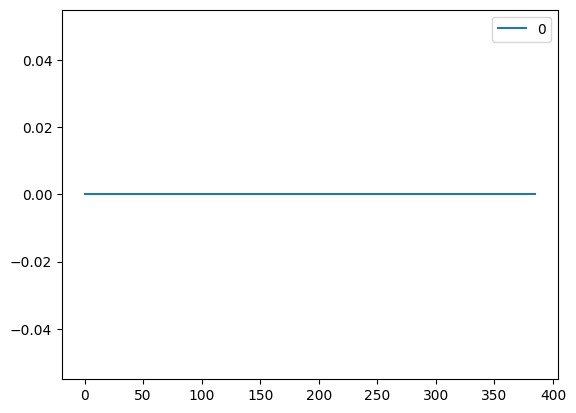

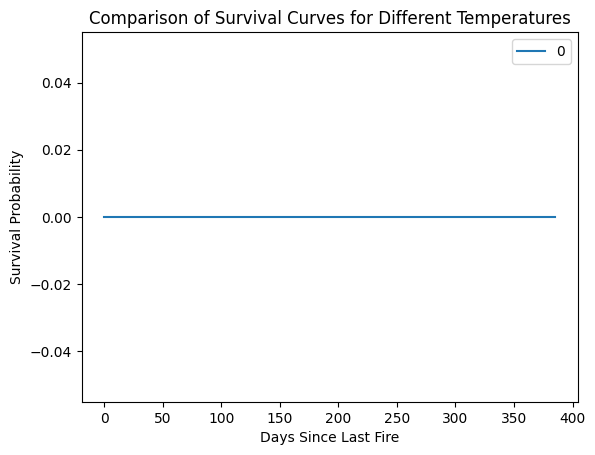

In [ ]:
# new_data_high_temp = pd.DataFrame({
#     'Temperature': [35],  # High temperature
#     'Humidity': [40],
#     'Wind_Speed': [15],
#     'Dew_Point': [25],
#     'Pressure': [1013],
#     'Precipitation': [0]
# })

# new_data_low_temp = pd.DataFrame({
#     'Temperature': [20],  # Low temperature
#     'Humidity': [40],
#     'Wind_Speed': [15],
#     'Dew_Point': [25],
#     'Pressure': [1013],
#     'Precipitation': [0]
# })

# # Plot survival curves for both scenarios
# cph.predict_survival_function(new_data_high_temp).plot(label="High Temperature")
# cph.predict_survival_function(new_data_low_temp).plot(label="Low Temperature")
# plt.xlabel("Days Since Last Fire")
# plt.ylabel("Survival Probability")
# plt.title("Comparison of Survival Curves for Different Temperatures")
# plt.legend()
# plt.show()